# Objetivos del TP
- Efectuar una limpieza del dataset provisto. Particularmente, deberán diseñar estrategias para lidiar con los datos perdidos en ciertas variables. 
- Realizar un análisis descriptivo de las principales variables. 
- Crear nuevas columnas a partir de las características dadas que puedan tener valor predictivo.

# **Preparacion del ambiente**

In [53]:
# corremos esto solo para colab
#from google.colab import drive
#drive.mount('/content/drive')

In [54]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
#!pip install seaborn
import seaborn as sns
#!pip install plotly==5.7.0
import plotly.express as px
from numpy.ma.core import count

In [55]:
# agregamos código para que identifique más de un display en una celda
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

# **Importación de los datos de properati y AR**


In [56]:
#leo el archivo de properati
#en colab
#csv_path ="/content/drive/MyDrive/DSDH/TP1/notebook para pc/properatti.csv"
#data = pd.read_csv(csv_path)

#en jupyter
data = pd.read_csv("../data/properatti.csv", sep = ",", low_memory=False) 
#data.head(3)

In [57]:
#import AR.csv trayendo algunas de las columnas que tienen info de ubicación
columnas = ['num', 'place_name', 'place_name2','s20', 'Lat','Lon', 's', 'rnch', 'Pais','s0','s1','s2','s3','s4','s5','s6','s7','place_with_parent_names','fecha']

#en colab
#dataAR = pd.read_csv("/content/drive/MyDrive/DSDH/TP1/AR.tsv", header=None, names=columnas,  usecols=[1,2,4,5,8,17], sep = "\t", low_memory=False) 
# en jupyter
dataAR = pd.read_csv("../data/AR.tsv", header=None, names=columnas,  usecols=[1,2,4,5,8,17], sep = "\t", low_memory=False) 

#elimino la cadena de caracteres America/ y separo la columna place_with_parent_names en columnas, 
#renombro las columnas resultantes para coincidir con las columnas de data
dataAR["place_with_parent_names"] = dataAR["place_with_parent_names"].replace({'America/':''}, regex=True)
dataAR[["country_name", "state_name"]] = dataAR["place_with_parent_names"].str.split("/", expand=True)
dataAR["state_name"]=dataAR["state_name"].replace({'_':' '}, regex=True)
dataAR.drop("place_with_parent_names", axis=1, inplace=True)
dataAR.head()

,place_name,place_name2,Lat,Lon,Pais,country_name,state_name
0,Sierra del 15,Sierra del 15,-37.96613,-57.94670,AR,Argentina,Buenos Aires
1,Puesto 1 Napoleón Cué,Puesto 1 Napoleon Cue,-28.63333,-56.11667,AR,Argentina,Cordoba
2,Cañada del Zorro,Canada del Zorro,-32.16667,-59.50000,AR,Argentina,Cordoba
3,Estancia Zorraquín,Estancia Zorraquin,-31.51553,-58.55208,AR,Argentina,Cordoba
4,Estancia Zequeira Cué,Estancia Zequeira Cue,-28.43825,-56.08838,AR,Argentina,Cordoba


# **Exploracion de datos**


Vamos a orientar la exploración en determinar: 

Descripción del dataset

¿Qué campos tienen valores nulos? y ¿Qué porcentaje de nulos tienen cada uno de ellos?

Revisar datos unique de las distintas columnas, y su homogeneidad

En columnas de texto libre, que tipo de información contienen? 

En columnas categóricas, cómo se distribuyen las categorías? 

En columnas numéricas, están muy sucias? se pueden calcular estadísticas de resúmen?

## Descripción del dataset

In [58]:
#cantidad de registros y columnas
data.shape

(121220, 26)

In [59]:
#tipo de datos en columnas
data.dtypes

Unnamed: 0                      int64
operation                      object
property_type                  object
place_name                     object
place_with_parent_names        object
country_name                   object
state_name                     object
geonames_id                   float64
lat-lon                        object
lat                           float64
lon                           float64
price                         float64
currency                       object
price_aprox_local_currency    float64
price_aprox_usd               float64
surface_total_in_m2           float64
surface_covered_in_m2         float64
price_usd_per_m2              float64
price_per_m2                  float64
floor                         float64
rooms                         float64
expenses                      float64
properati_url                  object
description                    object
title                          object
image_thumbnail                object
dtype: objec

In [60]:
#nombres de las columnas
data.columns

Index(['Unnamed: 0', 'operation', 'property_type', 'place_name',
       'place_with_parent_names', 'country_name', 'state_name', 'geonames_id',
       'lat-lon', 'lat', 'lon', 'price', 'currency',
       'price_aprox_local_currency', 'price_aprox_usd', 'surface_total_in_m2',
       'surface_covered_in_m2', 'price_usd_per_m2', 'price_per_m2', 'floor',
       'rooms', 'expenses', 'properati_url', 'description', 'title',
       'image_thumbnail'],
      dtype='object')

## Datos unique
Tomamos aquellas columnas con menos de 40 valores distintos (para evitar sobrecargar la salida) y las analizamos para ver valores.


In [61]:
####  distribución columns
for i in data.columns:
  if len(data[i].unique()) < 40:
    print(f'''{data[i].name}\n{data[i].unique()}\n''')

operation
['sell']

property_type
['PH' 'apartment' 'house' 'store']

country_name
['Argentina']

state_name
['Capital Federal' 'Bs.As. G.B.A. Zona Sur' 'Buenos Aires Costa Atlántica'
 'Entre Ríos' 'Bs.As. G.B.A. Zona Norte' 'Santa Fe' 'Córdoba'
 'Bs.As. G.B.A. Zona Oeste' 'Misiones' 'Buenos Aires Interior' 'Salta'
 'Neuquén' 'Río Negro' 'San Luis' 'Mendoza' 'Corrientes' 'Chubut'
 'Tucumán' 'La Pampa' 'Chaco' 'San Juan' 'Santa Cruz' 'Tierra Del Fuego'
 'Catamarca' 'Santiago Del Estero' 'Jujuy' 'La Rioja' 'Formosa']

currency
['USD' nan 'ARS' 'PEN' 'UYU']

rooms
[nan  1.  4.  3.  2.  6.  5. 10.  7.  9.  8. 17. 22. 15. 12. 11. 14. 16.
 20. 13. 25. 19. 30. 18. 32. 24. 31. 21. 29. 27. 23. 28.]



In [62]:
# aquí cuantificamos valores unicos en columnas con menos de 40 valores único.
# de esta manera podemos tomar decisiones sobre registros que podemos eliminar por no ser significativos
# de esta manera identificamos columnas que nos pueden servir par hacer exploraciones visuales
for i in data.columns:
  if len(data[i].unique()) < 40:
    print(f'''{data[i].name}\n{data[i].value_counts()}\n-----------------------------------------------''')

operation
sell    121220
Name: operation, dtype: int64
-----------------------------------------------
property_type
apartment    71065
house        40268
PH            5751
store         4136
Name: property_type, dtype: int64
-----------------------------------------------
country_name
Argentina    121220
Name: country_name, dtype: int64
-----------------------------------------------
state_name
Capital Federal                 32316
Bs.As. G.B.A. Zona Norte        25560
Bs.As. G.B.A. Zona Sur          13952
Córdoba                         12069
Santa Fe                        10172
Buenos Aires Costa Atlántica    10006
Bs.As. G.B.A. Zona Oeste         9322
Buenos Aires Interior            2291
Río Negro                         808
Neuquén                           733
Mendoza                           681
Tucumán                           674
Corrientes                        583
Misiones                          464
Entre Ríos                        369
Salta                         

In [63]:
#veo a que tipo de propiedades corresponden los registros con rooms mayor a 10
rooms = data["rooms"] > 10
big_rooms = data[rooms]
#print(big_rooms.groupby("property_type")["surface_total_in_m2"].mean())
big_rooms.head(3)


,Unnamed: 0,operation,property_type,place_name,place_with_parent_names,country_name,state_name,geonames_id,lat-lon,lat,...,surface_covered_in_m2,price_usd_per_m2,price_per_m2,floor,rooms,expenses,properati_url,description,title,image_thumbnail
876,876,sell,apartment,San Nicolás,|Argentina|Capital Federal|San Nicolás|,Argentina,Capital Federal,6693229.0,"-34.605661,-58.388343",-34.605661,...,382.0,NaN,654.450262,1.0,17.0,NaN,http://www.properati.com.ar/15gam_venta_depart...,Corredor Responsable: Mario Gabriel Gerez - CU...,Venta Hotel Familiar en 2 pisos,https://thumbs4.properati.com/7/FNzaAuAMg0iI0A...
877,877,sell,apartment,Monserrat,|Argentina|Capital Federal|Monserrat|,Argentina,Capital Federal,3430570.0,"-34.609988,-58.374932",-34.609988,...,472.0,NaN,635.593220,1.0,22.0,NaN,http://www.properati.com.ar/15gap_venta_depart...,Corredor Responsable: Mario Gabriel Gerez - CU...,Venta Hotel Familiar Calle Peru al 100,https://thumbs4.properati.com/1/6N7K5-4_54qOYo...
1601,1601,sell,house,La Granja,|Argentina|Córdoba|La Granja|,Argentina,Córdoba,3851072.0,"-31.013881,-64.268614",-31.013881,...,421.0,NaN,688.836105,NaN,15.0,NaN,http://www.properati.com.ar/15ivs_venta_casa_l...,Corredor Responsable: Matiaz Ruiz Moreno - CPC...,Vendo Importante Casa La Granja,https://thumbs4.properati.com/8/7fATYv6JIhiCtA...


Conclusión datos unique:

property_type: La columna property_type trae 4 categorías (casa, departamento, local y ph), agrupando las dos primeras categorías el 92% del total de las publicaciones.

state_name: La columna state_name posee 28 categorias divididos por provincias, CABA y zonas de GBA. Parecería estar límpia. 

currency: En la columna currency existen 4 categorías, correspondiendo solo 3 registros a PEN y UYU por lo que se deciden excluir dichos registros. 

rooms: Está columna posee 31 categorías, agrupando la mayor proporción de registros entre 1 y 10 rooms. Esta columna posee un alto porcentaje de null, pero también encontramos datos que a priori pueden parecer raros, hicimos un análisis sobre registros con +10 rooms para entender si eran hoteles o complejos. Detectamos que en algunos casos son complejos o posados, en otros casos por ejemplo son apartamentos con 4 habitaciones + 3 baños + etc.


## Nulls. ¿Qué campos tienen valores nulos? y ¿Qué porcentaje de nulos tienen cada uno de ellos?

[Text(0, 0.5, '% Nulos'),
 Text(0.5, 0, 'Columnas'),
 Text(0.5, 1.0, 'Datos nulos')]

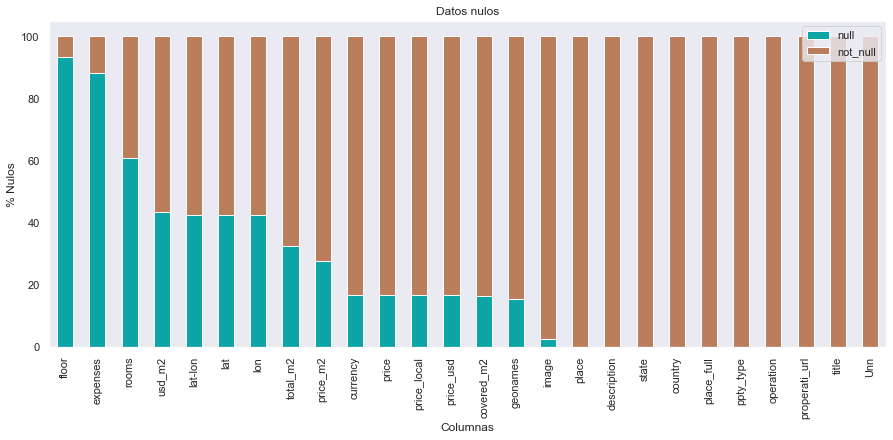

In [64]:
# Representamos gráficamente los nulos por columna

# Cambiamos los nombres de las columnas para que sea más legible y creamos un diccionario para mapear
cols_plt = ['Unn', 'operation', 'ppty_type', 'place',
       'place_full', 'country', 'state', 'geonames',
       'lat-lon', 'lat', 'lon', 'price', 'currency',
       'price_local', 'price_usd', 'total_m2',
       'covered_m2', 'usd_m2', 'price_m2', 'floor',
       'rooms', 'expenses', 'properati_url', 'description', 'title',
       'image']

cols_dict = dict(zip(data.columns, cols_plt))

# Creamos un nuevo dataframe para hacer el gráfico, sólo con dos columnas, % de nulos y no nulos por variable
null = data.apply(lambda x: x.isnull().sum() / data.shape[0] * 100)
not_null = data.apply(lambda x: x.notnull().sum() / data.shape[0] * 100)
sry_null = pd.DataFrame({'null': null, 'not_null': not_null})

# Estilo de gráfico con seaborn
sns.set(style = 'dark')

# Creo el gráfico reemplazando el nombre de las variables por uno más corto y ordenando antes
fig, ax = plt.figure(figsize = (15, 6)), plt.axes()
sry_null.rename(index = cols_dict).sort_values(by = 'not_null').plot(kind = 'bar', stacked = True, color = ['#0CA4A5', '#BB7E5D'], ax = ax)

# seteo la posición de la leyenda y los títulos para los ejes y la figura
ax.set(xlabel = 'Columnas', ylabel = '% Nulos', title = 'Datos nulos')
ax.legend(loc = 'upper right')
# Guardo la imagen
#en colab
#images_dir = '/content/drive/My Drive/DSDH/TP1/Imagenes/null_barplot.png'
#en jupyter
plt.show()
#plt.savefig("null_barplot.png", dpi = 150, bbox_inches = 'tight', pad_inches = 0.1)


In [65]:
##  ¿Qué campos tienen valores nulos? y cual es su porcentaje en la columna
cant_nulos_por_campo = data.apply(lambda x: x.isnull().sum(), axis=0)
percent_nulos_por_campo = data.apply(lambda x: (100 * x.isnull().sum() / data.shape[0]).round(2), axis=0)
summary_nulos_por_campo = pd.DataFrame({ 'cant': cant_nulos_por_campo, 'percent': percent_nulos_por_campo ,'tipo': data.dtypes})
print(summary_nulos_por_campo)

                              cant  percent     tipo
Unnamed: 0                       0     0.00    int64
operation                        0     0.00   object
property_type                    0     0.00   object
place_name                      23     0.02   object
place_with_parent_names          0     0.00   object
country_name                     0     0.00   object
state_name                       0     0.00   object
geonames_id                  18717    15.44  float64
lat-lon                      51550    42.53   object
lat                          51550    42.53  float64
lon                          51550    42.53  float64
price                        20410    16.84  float64
currency                     20411    16.84   object
price_aprox_local_currency   20410    16.84  float64
price_aprox_usd              20410    16.84  float64
surface_total_in_m2          39328    32.44  float64
surface_covered_in_m2        19907    16.42  float64
price_usd_per_m2             52603    43.39  f

###Nulos por property_type

Vamos a analizar cantidad de null por tipo de propiedad para determinar sí una de ellas nos dá mayor precision sobre la información.
Para ello creamos máscaras por tipo de propiedad.

In [66]:
# Creamos 4 datasets distintos a partir de cada tipo de propiedad (ph, departamento, casa y negocio)
data_ph, data_ap, data_ho, data_st = data.loc[data.property_type == 'PH'], data.loc[data.property_type == 'apartment'], data.loc[data.property_type == 'house'], data.loc[data.property_type == 'store']

1. Analizamos Propiedades Tipo PH

In [67]:
##ph
##  ¿Qué campos tienen valores nulos? 
cant_nulos_por_campo = data_ph.apply(lambda x: x.isnull().sum(), axis=0)
percent_nulos_por_campo = data_ph.apply(lambda x: (100 * x.isnull().sum() / data_ph.shape[0]).round(2), axis=0)
summary_nulos_por_campo = pd.DataFrame({ 'cant': cant_nulos_por_campo, 'percent': percent_nulos_por_campo })
print(summary_nulos_por_campo)
#distribución columna property_type
#data.property_type.unique()

                            cant  percent
Unnamed: 0                     0     0.00
operation                      0     0.00
property_type                  0     0.00
place_name                     0     0.00
place_with_parent_names        0     0.00
country_name                   0     0.00
state_name                     0     0.00
geonames_id                  729    12.68
lat-lon                     1896    32.97
lat                         1896    32.97
lon                         1896    32.97
price                        531     9.23
currency                     531     9.23
price_aprox_local_currency   531     9.23
price_aprox_usd              531     9.23
surface_total_in_m2         2150    37.38
surface_covered_in_m2        838    14.57
price_usd_per_m2            2497    43.42
price_per_m2                1199    20.85
floor                       5178    90.04
rooms                       2504    43.54
expenses                    5403    93.95
properati_url                  0  

2. Analizamos Propiedades Tipo Apartamento

In [68]:
##ap
##  ¿Qué campos tienen valores nulos? 
cant_nulos_por_campo = data_ap.apply(lambda x: x.isnull().sum(), axis=0)
percent_nulos_por_campo = data_ap.apply(lambda x: (100 * x.isnull().sum() / data_ap.shape[0]).round(2), axis=0)
summary_nulos_por_campo = pd.DataFrame({ 'cant': cant_nulos_por_campo, 'percent': percent_nulos_por_campo })
print(summary_nulos_por_campo)
#distribución columna property_type
#data.property_type.unique()

                             cant  percent
Unnamed: 0                      0     0.00
operation                       0     0.00
property_type                   0     0.00
place_name                      1     0.00
place_with_parent_names         0     0.00
country_name                    0     0.00
state_name                      0     0.00
geonames_id                  8683    12.22
lat-lon                     29428    41.41
lat                         29428    41.41
lon                         29428    41.41
price                       11449    16.11
currency                    11449    16.11
price_aprox_local_currency  11449    16.11
price_aprox_usd             11449    16.11
surface_total_in_m2         19980    28.12
surface_covered_in_m2       11330    15.94
price_usd_per_m2            28178    39.65
price_per_m2                18871    26.55
floor                       64544    90.82
rooms                       39797    56.00
expenses                    59861    84.23
properati_u

3. Analizamos Propiedades Tipo House

In [69]:
##ho
##  ¿Qué campos tienen valores nulos? 
cant_nulos_por_campo = data_ho.apply(lambda x: x.isnull().sum(), axis=0)
percent_nulos_por_campo = data_ho.apply(lambda x: (100 * x.isnull().sum() / data_ho.shape[0]).round(2), axis=0)
summary_nulos_por_campo = pd.DataFrame({ 'cant': cant_nulos_por_campo, 'percent': percent_nulos_por_campo })
print(summary_nulos_por_campo)
#distribución columna property_type
#data.property_type.unique()

                             cant  percent
Unnamed: 0                      0     0.00
operation                       0     0.00
property_type                   0     0.00
place_name                     22     0.05
place_with_parent_names         0     0.00
country_name                    0     0.00
state_name                      0     0.00
geonames_id                  8764    21.76
lat-lon                     18344    45.55
lat                         18344    45.55
lon                         18344    45.55
price                        7553    18.76
currency                     7554    18.76
price_aprox_local_currency   7553    18.76
price_aprox_usd              7553    18.76
surface_total_in_m2         15763    39.15
surface_covered_in_m2        6758    16.78
price_usd_per_m2            19909    49.44
price_per_m2                11915    29.59
floor                       39503    98.10
rooms                       27498    68.29
expenses                    37960    94.27
properati_u

4. Analizamos Propiedades Tipo Store

In [70]:
##st
##  ¿Qué campos tienen valores nulos? 
cant_nulos_por_campo = data_st.apply(lambda x: x.isnull().sum(), axis=0)
percent_nulos_por_campo = data_st.apply(lambda x: (100 * x.isnull().sum() / data_st.shape[0]).round(2), axis=0)
summary_nulos_por_campo = pd.DataFrame({ 'cant': cant_nulos_por_campo, 'percent': percent_nulos_por_campo })
print(summary_nulos_por_campo)
#distribución columna property_type
#data.property_type.unique()

                            cant  percent
Unnamed: 0                     0     0.00
operation                      0     0.00
property_type                  0     0.00
place_name                     0     0.00
place_with_parent_names        0     0.00
country_name                   0     0.00
state_name                     0     0.00
geonames_id                  541    13.08
lat-lon                     1882    45.50
lat                         1882    45.50
lon                         1882    45.50
price                        877    21.20
currency                     877    21.20
price_aprox_local_currency   877    21.20
price_aprox_usd              877    21.20
surface_total_in_m2         1435    34.70
surface_covered_in_m2        981    23.72
price_usd_per_m2            2019    48.82
price_per_m2                1577    38.13
floor                       4096    99.03
rooms                       4031    97.46
expenses                    3734    90.28
properati_url                  0  

### Exploracion valores nulos: Conclusiones
De las columnas más importantes para posteriores usos, vemos que las columnas lat-lon, lat y lon tienen un 42% de nulos (debemos determinar si corresponden a los mismos registros).

Price, currency, price_aprox_local_currency y price_aprox_usd tienen un 16.84% de nulos (debemos determinar si corresponden a los mismos registros, en dicho caso es más difícil de inferir valores).

Las columnas floor y expenses tienen porcentajes muy altos de nulos (93% y 88% respectivamente). Podemos determinar un umbral de nulos por columna por encima del cual la columna se elimina, o al menos no se tiene en cuenta en el análisis.

Para el caso de la columna rooms, que tiene cerca del 61% de nulos, se puede buscar dentro de otras columnas si existe información respecto de este valor.

Agregamos un análisis  por tipo de propiedad, pensando en que si tal vez alguna mejoras los null considerablemente, podíamos basarnos en ella, pero no fue el caso, y cada tipo de propiedad tiene porcentajes similares de null en las columnas más importantes.


## Texto libre. En columnas de texto qué libre tipo de información traen

Analizamos Title, Description y URL. Vimos que contienen información respecto de ambientes y/o habitaciones, amenities o adicionales al tipo de propiedad que eventualmente puede incidir en el precio, y en aquellos ubicados en CABA mencionan la cercanía a una línea de subte.

In [71]:
data["title"].head()

0                   2 AMB TIPO CASA SIN EXPENSAS EN PB
1    VENTA Depto 2 dorm. a estrenar 7 e/ 36 y 37   ...
2             2 AMB 3ER PISO CON ASCENSOR APTO CREDITO
3                         PH 3 amb. cfte. reciclado   
4    DEPTO 2 AMB AL CONTRAFRENTE ZONA CENTRO/PLAZA ...
Name: title, dtype: object

In [72]:
data["description"].head()

0    2 AMBIENTES TIPO CASA PLANTA BAJA POR PASILLO,...
1    Venta de departamento en décimo piso al frente...
2    2 AMBIENTES 3ER PISO LATERAL LIVING COMEDOR AM...
3    PH 3 ambientes con patio. Hay 3 deptos en lote...
4    DEPARTAMENTO CON FANTÁSTICA ILUMINACIÓN NATURA...
Name: description, dtype: object

In [73]:
data["properati_url"].head()

0    http://www.properati.com.ar/15bo8_venta_ph_mat...
1    http://www.properati.com.ar/15bob_venta_depart...
2    http://www.properati.com.ar/15bod_venta_depart...
3    http://www.properati.com.ar/15boh_venta_ph_lin...
4    http://www.properati.com.ar/15bok_venta_depart...
Name: properati_url, dtype: object

CONCLUSION: Estas columnas puede devolvernos algún dato predictivo o de información adicional que nos permita determinar si el precio de una propiedad tiene alguna caracteristica que influya sobre su precio. Trabajaremos en la sección imputaciones sobre ellas.

## Columnas categóricas. Como se distribuyen las categorías? 

Las columnas con categorías son
- operation
- property_type
- place_name (nivel partido para PBA / localidad para las restantes provincias)
- place_with_parent_name (agrega información de barrio)
- country_name
- state_name (Nivel provincia / Barrio para CABA
- currency



### Función de graficos generales

In [74]:
#funcion para graficar columnas categóricas

def distribution_plotter(data, label, bins="auto"):    
    plt.figure(figsize = (15,5))
    sns.set_style("white")    
    dist = sns.histplot(data, bins=bins, stat = "count", kde = False, 
                        line_kws = {'linewidth':5}, 
                        binwidth = 500)    
    dist.set_title('Distribucion ', fontsize = 16)
    plt.xticks(rotation=45, ha='right')

### Country_name y operation

Tienen un único valor cada una (Argentina y sell), y no tienen valores nulos.
No se necesita un análisis adicional

### Property_type

In [75]:
#analizo la columna property_type para ver la distribución y porcentaje de cada valor unique (frecuencia)
property_prop = pd.DataFrame({ 'tipo': data.property_type.value_counts(), 'percent': (100*data.property_type.value_counts())/data.shape[0]})
property_prop

,tipo,percent
apartment,71065,58.624814
house,40268,33.218941
PH,5751,4.744267
store,4136,3.411978


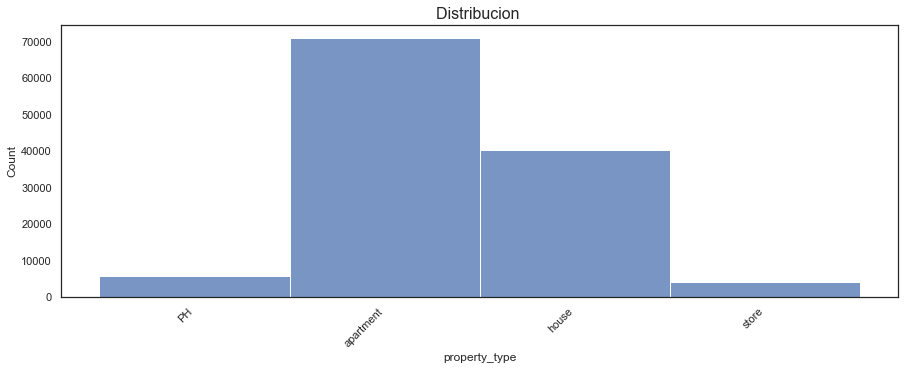

In [76]:
#graficar property_type
labels = data.property_type.unique()
distribution_plotter(data.property_type,labels)

### State_name

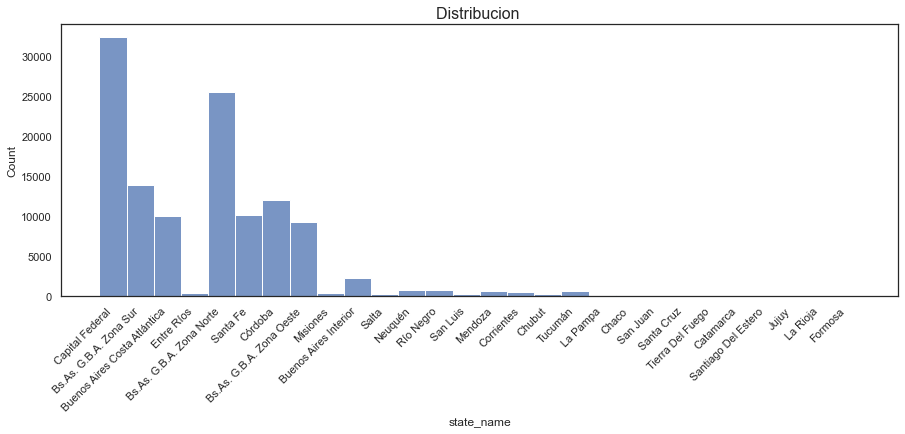

In [77]:
#graficar frecuencia de 'state_name'
labels = data.state_name.unique()
distribution_plotter(data.state_name,labels)

In [78]:
#analizo la columna state_name para ver la distribución y porcentaje de cada valor unique (frecuencia)
percent = (100*data.state_name.value_counts())/data.shape[0]
state_prop = pd.DataFrame({ 'state_name': data.state_name.value_counts(), 'percent': (100*data.state_name.value_counts())/data.shape[0], 'cumpercent': percent.cumsum()})
state_prop

,state_name,percent,cumpercent
Capital Federal,32316,26.658967,26.658967
Bs.As. G.B.A. Zona Norte,25560,21.085629,47.744597
Bs.As. G.B.A. Zona Sur,13952,11.509652,59.254248
Córdoba,12069,9.956278,69.210526
Santa Fe,10172,8.391355,77.601881
Buenos Aires Costa Atlántica,10006,8.254413,85.856294
Bs.As. G.B.A. Zona Oeste,9322,7.690150,93.546444
Buenos Aires Interior,2291,1.889952,95.436397
Río Negro,808,0.666557,96.102953
Neuquén,733,0.604686,96.707639


In [79]:
#agrupo por state_name para ver los valores únicos de place_name en cada uno
state = data.groupby("state_name")["place_name"].value_counts()
state.sort_values(ascending=False).head(10)


state_name                    place_name   
Córdoba                       Córdoba          9254
Santa Fe                      Rosario          8504
Buenos Aires Costa Atlántica  Mar del Plata    6534
Bs.As. G.B.A. Zona Norte      Tigre            3324
                              Nordelta         3315
Capital Federal               Belgrano         2992
                              Palermo          2885
Bs.As. G.B.A. Zona Sur        La Plata         2534
Capital Federal               Caballito        2273
Bs.As. G.B.A. Zona Norte      Pilar            2225
Name: place_name, dtype: int64

Conclusión: El 95.5% de los registros corresponden a las provincias de Buenos Aires, Santa Fe, Córdoba y CABA.

### Columna place_with_parent_names

Por la información previsualizada parecería que el valor de esta columna es la  sumatoria de otras columnas (country, state y place).
Intentamos determinar si es así, o si contiene información adicional.

In [80]:
#determino si el valor de place_with_parent_name es igual a la suma de country_name, state_name y place_name
#pruebo "compare" entre una columna nueva que agrupa pais, state y place, y la columna place_with_parent_name para ver 
data["agrupado"] = "|" + data["country_name"] +"|" + data["state_name"] + "|" + data["place_name"] + "|"
data["agrupado"].compare(data["place_with_parent_names"], align_axis = 1, keep_shape = True, keep_equal = False)

#place_with_parent_name no es igual a la sumatoria de las otras columnas
#me fijo cuántos registros hay distintos 
data["agrupado"].compare(data["place_with_parent_names"], align_axis = 1, keep_shape = True, keep_equal = False).notnull().sum() 

,self,other
0,NaN,NaN
1,NaN,NaN
2,NaN,NaN
3,NaN,NaN
4,|Argentina|Buenos Aires Costa Atlántica|Centro|,|Argentina|Buenos Aires Costa Atlántica|Mar de...
...,...,...
121215,NaN,NaN
121216,|Argentina|Bs.As. G.B.A. Zona Norte|Beccar|,|Argentina|Bs.As. G.B.A. Zona Norte|San Isidro...
121217,NaN,NaN
121218,|Argentina|Buenos Aires Costa Atlántica|Plaza ...,|Argentina|Buenos Aires Costa Atlántica|Mar de...


self     45197
other    45220
dtype: int64

La columna place_with_parent_name no es igual a la sumatoria de las otras columnas, hay 45.000 registros distintos, que contienen información adicional a la suma de country, state y place name. 
Dividimos la columna por separadores, generándose 6 columnas en total. 
Determino si la columna 1 es equivalente a Country_name, la 2 a state_name y la 3 a place_name. 
Me fijo qué tipo de información hay en las columnas 4, 5 y 6
En algunos casos contiene + 1 de un valor categórico adicional.

In [81]:
#exploro a ver qué tipo de información adicional trae place_with_parent_names
#divido la columna place_with_parent_names por separador
pwpn_split = data["place_with_parent_names"].str.split('|', expand=True)
pwpn_split.columns

RangeIndex(start=0, stop=7, step=1)

In [82]:
col1 = pwpn_split[1]  
col2 = pwpn_split[2]
col3 = pwpn_split[3]

In [83]:
#me fijo si las 3 primeras divisiones coinciden con country, state y place
print(f'''
Country_name y Col1 son iguales: {np.logical_and(data['country_name'].isnull(), col1.isnull()).sum() == np.logical_or(data['country_name'].isnull(), col1.isnull()).sum()}
State_name y Col2 son iguales: {np.logical_and(data['state_name'].isnull(), col2.isnull()).sum() == np.logical_or(data['state_name'].isnull(), col2.isnull()).sum()}
Place_name y Col3 son iguales: {np.logical_and(data['place_name'].isnull(), col3.isnull()).sum() == np.logical_or(data['place_name'].isnull(), col3.isnull()).sum()}''')



Country_name y Col1 son iguales: True
State_name y Col2 son iguales: True
Place_name y Col3 son iguales: False


CONCLUSION:
En el dataset de properati, la columna state_name trae información distinta según la ubicación de la que se trate (en casos es provincia, en otros ciudad y en otros una zona de una provincia). A partir de allí, los datos contenidos en el nivel inferior (place_name) dependerán de lo que había en state_name.

La columna place_with_parent_names trae la información contenida en country, state y place name más información adicional de barrio o barrio privado. Podemos decir que esta columna nos aporta una identificación más refinada sobre la ubicación de la propiedad a la hora de determinar su precio por m2.

### Currency

In [84]:
# contamos valores opr moneda
# se observa que PEN y UYU puede ser eliminados, no tiene reelevancia
datacurrency = data.currency
datacurrency.value_counts()

USD    87587
ARS    13219
PEN        2
UYU        1
Name: currency, dtype: int64

CONCLUSION: 
La columna Currency posee muy pocos registros con monedas distintas a USD y ARS por lo que nos quedaremos solo con USD y ARS, ya que no son significativos los registros PEN y UYU.

Nos quedaremos solo con USD y ARS, ya que no son significativos los registros PEN y UYU.


## En columnas numéricas, contienen muchos outliers? se pueden calcular estadísticas de resúmen?

Aquí realizamos un Describe sobre las principales columnas numéricas, calculamos el coeficiente de variación de cada una para justificar que en cada caso tenemos mucha dispersión debido a los outliers.

las columnas numéricas importantes son 
- lat                         
- lon                         
- price                        
- price_aprox_local_currency   
- price_aprox_usd              
- surface_total_in_m2          
- surface_covered_in_m2        
- price_usd_per_m2             
- price_per_m2                 
- floor                      
- rooms                       
- expenses

In [85]:
#hago un describe de las columnas numéricas sin ninguna limpieza ni imputación para ver valores extremos, y estadísticas básicas

columns=['price','price_aprox_local_currency','price_aprox_usd','surface_total_in_m2', 'surface_covered_in_m2', 'price_usd_per_m2', 'price_per_m2']
data[columns].describe().round()

,price,price_aprox_local_currency,price_aprox_usd,surface_total_in_m2,surface_covered_in_m2,price_usd_per_m2,price_per_m2
count,100810.0,100810.0,100810.0,81892.0,101313.0,68617.0,87658.0
mean,468526.0,4229397.0,239701.0,234.0,133.0,2160.0,6912.0
std,2260101.0,6904714.0,391324.0,1782.0,724.0,2759.0,28379.0
min,0.0,0.0,0.0,0.0,0.0,1.0,2.0
25%,110000.0,1583309.0,89734.0,50.0,45.0,1218.0,1550.0
50%,185000.0,2558452.0,145000.0,84.0,75.0,1800.0,2213.0
75%,420000.0,4675792.0,265000.0,200.0,150.0,2486.0,3356.0
max,650000000.0,821271104.0,46545445.0,200000.0,187000.0,206333.0,4000000.0


In [86]:
#calculamos el coeficiente de variación de cada una de estas medidas
print('CoefVariación_price:',  data.price.std() / data.price.mean())
print('CoefVariación_price_aprox_local_currency:',  data.price_aprox_local_currency.std() / data.price_aprox_local_currency.mean())
print('CoefVariación_price_aprox_usd:',  data.price_aprox_usd.std() / data.price_aprox_usd.mean())

print('CoefVariación_surface_total_in_m2:',  data.surface_total_in_m2.std() / data.surface_total_in_m2.mean())
print('CoefVariación_surface_covered_in_m2:',  data.surface_covered_in_m2.std() / data.surface_covered_in_m2.mean())
print('CoefVariación_price_usd_per_m2:',  data.price_usd_per_m2.std() / data.price_usd_per_m2.mean())
print('CoefVariación_price_per_m2:',  data.price_per_m2.std() / data.price_per_m2.mean())

CoefVariación_price: 4.8238538496819405
CoefVariación_price_aprox_local_currency: 1.6325529159736716
CoefVariación_price_aprox_usd: 1.632552915585356
CoefVariación_surface_total_in_m2: 7.6230015471435495
CoefVariación_surface_covered_in_m2: 5.444197615654832
CoefVariación_price_usd_per_m2: 1.2773970348937533
CoefVariación_price_per_m2: 4.105578579577064


CONCLUSION: Vemos que tenemos grandes dispersiones de datos valida la información en en el Describe con el cálculo hecho para cada columna de Coeficiente de Variación

### Columnas Price y Price_aprox_usd

Primeramente analizamos estas columnas, que son las deseadas para trabajar.
La comparamos con la columna Price para entender su relación y allí vemos que dicha columna trae los valores según el tipo de "Currency" declarado, analizaremos en produfundidad la columna "Price" mas adelante.

La columna price posee valores muy dispares porque incluye precios en las distintas monedas. 

A los fines del análisis pensamos elegir las columnas price_aprox_local_currency  y price_aprox_usd, que tienen unificada la moneda utilizada, y en una decisión final, nos quedamos únicamente con la columna price_aprox_usd que posee todos los valores en USD.



In [87]:
print(data['price'].max())
print(data['price_aprox_usd'].max())
print(data['price_aprox_local_currency'].max())

650000000.0
46545445.0
821271104.3


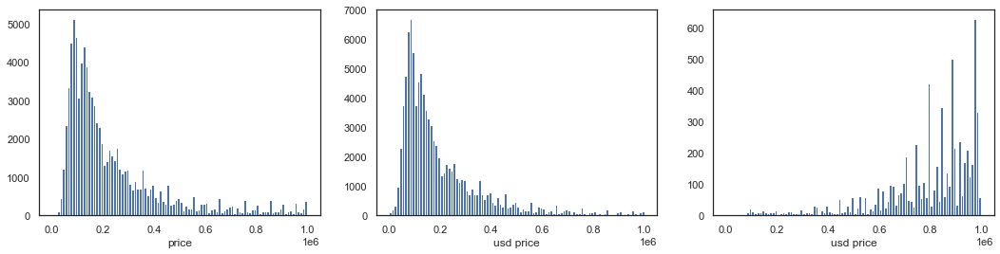

In [88]:
#comparo la distribución de price vs price_aprox_usd
fig, ax = plt.subplots(ncols = 3, figsize = (18, 4))

#"_ =" elimina el output de los array
_ = ax[0].hist(data['price'], bins=100,range = [0, 1000000])
_ = ax[0].set_xlabel('price')
_ = ax[1].hist(data['price_aprox_usd'], bins=100,range = [0, 1000000])
_ = ax[1].set_xlabel('usd price')
_ = ax[2].hist(data['price_aprox_local_currency'], bins=100,range = [0, 1000000])
_ = ax[2].set_xlabel('usd price')
plt.show()



### Surface_total_in_m2

In [89]:
data['surface_total_in_m2'].describe()

count     81892.000000
mean        233.795328
std        1782.222147
min           0.000000
25%          50.000000
50%          84.000000
75%         200.000000
max      200000.000000
Name: surface_total_in_m2, dtype: float64

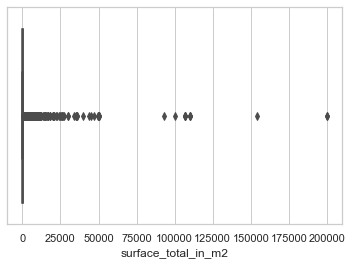

In [90]:
sns.set_theme(style="whitegrid")
ax = sns.boxplot(x=data['surface_total_in_m2'])

In [91]:
#aplico una máscara para considerar los valores de m2 mayores a 10000 (una hectárea) o que no sean nulos a ver qué valores tienen
#para ver si los consideramos outliers
mask=(data['surface_total_in_m2']> 10000) & (data['surface_total_in_m2'].isnull() == False)
data[mask]['surface_total_in_m2'].sort_values(ascending=False)


24548     200000.0
13405     200000.0
44246     154438.0
53314     110000.0
53313     110000.0
            ...   
69115      10958.0
8355       10500.0
5181       10400.0
113855     10048.0
53173      10020.0
Name: surface_total_in_m2, Length: 73, dtype: float64

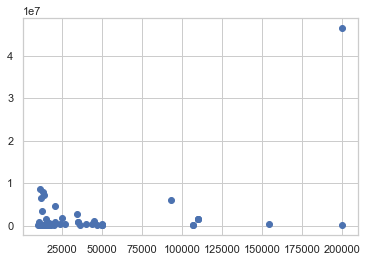

In [92]:
#grafico como scatter los registros con más de 1 hectárea
plt.scatter(data[mask]['surface_total_in_m2'],data[mask]['price_aprox_usd'])
plt.show()

### Columnas price_per_m2 y price_usd_per_m2

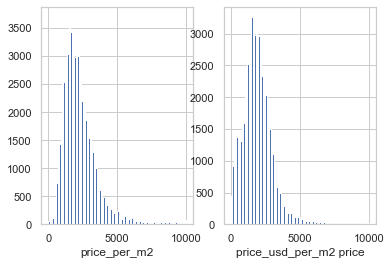

In [93]:
#comparo la distribución de price_per_m2 y price_usd_per_m2
fig, ax = plt.subplots(1, 2)

_=ax[0].hist(data['price_per_m2'], bins=100,range = [0, 10000])
_=ax[0].set_xlabel('price_per_m2')
_=ax[1].hist(data['price_usd_per_m2'], bins=100,range = [0, 10000])
_=ax[1].set_xlabel('price_usd_per_m2 price')
plt.show()

count     68617.000000
mean       2160.086916
std        2759.288621
min           0.600000
25%        1218.181818
50%        1800.000000
75%        2486.411765
max      206333.333333
Name: price_usd_per_m2, dtype: float64

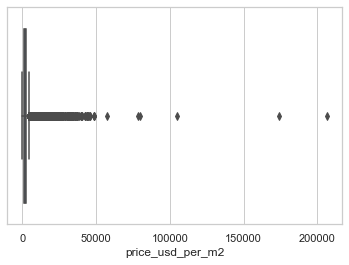

In [94]:
sns.set_theme(style="whitegrid")
ax = sns.boxplot(x=data['price_usd_per_m2'])
data.price_usd_per_m2.describe()

### Tipo de cambio implicito de las operaciones

In [95]:
# VAMOS A HACER UN MASK CON CURRENCY ARS, Y VAMOS A VERIFICAR LOS VALORES QUE TRAE LA COLUMNA PRICE LOCAL CURRENCY Y PRICE USD.
# LUEGO CALCULAMOS EL COCIENTE Y VEMOS SI TENEMOS REGISTROS QUE NO TIENEN UNO DE LOS DOS VALORES O EL TIPO DE CAMBIO IMPLICITO UTILIZADO
maskARS = data.currency == 'ARS'
dataARS = data[maskARS]
dataARS.loc[:,['price_aprox_local_currency', 'price_aprox_usd']]

,price_aprox_local_currency,price_aprox_usd
9,455201.45,25798.49
32,544262.59,30846.02
37,1236960.43,70104.59
78,5442626.35,308460.22
97,1408947.37,79851.93
...,...,...
121202,1491279.61,84518.10
121203,1486331.74,84237.68
121204,1486331.74,84237.68
121205,1491279.61,84518.10


In [96]:
#verificamos que ambas columnas tengas damos, sacando un cociente y vemos si tenemos null
data['tipodecambio_implicito'] = data['price_aprox_local_currency'] / data['price_aprox_usd']

In [97]:
# acá identificamos que utiliza un único tipo de cambio
tipodecambioarray = data['tipodecambio_implicito'].round(2).unique()
tipodecambio = tipodecambioarray[0]
print(tipodecambioarray)
print(tipodecambio)

[17.64   nan]
17.64


In [98]:
# usar este codigo para comparar con lat lon  y lat-lon
data.loc[:,['price_aprox_local_currency', 'price_aprox_usd','tipodecambio_implicito']].sort_values('tipodecambio_implicito')

,price_aprox_local_currency,price_aprox_usd,tipodecambio_implicito
53678,91603.53,5191.62,17.644498
76101,108852.44,6169.20,17.644498
66969,108852.44,6169.20,17.644498
116091,108852.44,6169.20,17.644498
62524,108852.44,6169.20,17.644498
...,...,...,...
121210,NaN,NaN,NaN
121211,NaN,NaN,NaN
121212,NaN,NaN,NaN
121213,NaN,NaN,NaN


In [99]:
# aqui verificamos el porque de los null en tipo de cambio
masktipodecambio = data.loc[:,'tipodecambio_implicito'].isnull()
print(data.loc[masktipodecambio,['price_aprox_local_currency']])
print(data.loc[masktipodecambio,['price_aprox_usd']])

        price_aprox_local_currency
5                              NaN
20                             NaN
41                             NaN
62                             NaN
67                             NaN
...                            ...
121210                         NaN
121211                         NaN
121212                         NaN
121213                         NaN
121214                         NaN

[20411 rows x 1 columns]
        price_aprox_usd
5                   NaN
20                  NaN
41                  NaN
62                  NaN
67                  NaN
...                 ...
121210              NaN
121211              NaN
121212              NaN
121213              NaN
121214              NaN

[20411 rows x 1 columns]


Conclusión: Comprobamos que cuando la columna cambio implicito trae NaN es por que no tiene precio ni en local currency ni en price usd. Matchear con lo que hizo enzo, que arribaba a la misma conclusion

Hicimos el mismo análisis filtrando por tipo de Moneda USD.
En este caso encontramos de que no existen nulls.

In [100]:
#seleccionamos solo campos con moneda USD
maskUSD = data.currency == 'USD'
dataUSD = data[maskUSD]
dataUSD.loc[:,['price_aprox_local_currency', 'price_aprox_usd']]

,price_aprox_local_currency,price_aprox_usd
0,1093959.00,62000.0
1,2646675.00,150000.0
2,1270404.00,72000.0
3,1676227.50,95000.0
4,1129248.00,64000.0
...,...,...
121215,15350715.00,870000.0
121216,8786961.00,498000.0
121217,2320251.75,131500.0
121218,1692107.55,95900.0


In [101]:
# VERIFICAMOS EL TIPO CAMBIO UTILIZADO
dataUSD['tipodecambio_implicito'] = dataUSD['price_aprox_local_currency'] / dataUSD['price_aprox_usd']
dataUSD['tipodecambio_implicito'].sort_values(ascending=False)

/mnt/Data/ProgramFiles/anaconda3/envs/dhds22gpd/lib/python3.7/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


0        17.644500
74900    17.644500
74898    17.644500
74897    17.644500
74896    17.644500
           ...    
66104    17.644499
26496    17.644499
26497    17.644499
26498    17.644499
26499    17.644499
Name: tipodecambio_implicito, Length: 87587, dtype: float64

In [102]:
# vemos sí hay mas de un tipo de cambio o NaN
tipodecambioarray = dataUSD['tipodecambio_implicito'].round(2).unique()
tipodecambio = tipodecambioarray[0]
print(tipodecambioarray)
print(tipodecambio)

[17.64]
17.64


Por último demostramos que cuando el campo price_aprox_local_currency es null, el campo price_aprox_usd también y no existe otra relación.

In [103]:
print(f'''COMPARACIÓN DE NaNs ENTRE COLUMNAS
True: nan & nan
False: nan & dato | dato & nan

VARIABLE\t\t\tNaN & NaN
price_local vs price_usd\t{np.logical_and(data['price_aprox_local_currency'].isnull(), data['price_aprox_usd'].isnull()).sum() == np.logical_or(data['price_aprox_local_currency'].isnull(), data['price_aprox_usd'].isnull()).sum()}''')

COMPARACIÓN DE NaNs ENTRE COLUMNAS
True: nan & nan
False: nan & dato | dato & nan

VARIABLE			NaN & NaN
price_local vs price_usd	True


Podemos concluir entonces que:
- Al analizar valores de propiedades, cuando tenemos NaN en "price_aprox_local_currency", también tenemos NaN en "price_aprox_usd"
- Los registros null solo aparecen para tipo de currency "ARS"
- El tipo de cambio implícito en el data set es 17.64

### Nivel de Expensas

Dado que el valor de expensas es muy relativo, lo que hicimos pensando en crear un factor que aplique sobre el valor predicitivo fué calcular la incidencia de las expensas sobre el valor de la propiedad y en base a ello crear "categorías" para luego hacerlas ponderar sobre el precio predecido.

In [104]:
#expenses
#dado que es un valor con muchos valores disitintos, se me ocurrio hacer un % de incidencia sobre el valor total de la propiedad, para luego hacer ponderar este sobre el valor de la propiedad
#dudas: los NaN los convertí a 0, supuse que todos los valores de expenses estan expresas en pesos
data['nivel_de_expensas'] = data['expenses'] / data['price_aprox_local_currency']
nivel_expensas = data.nivel_de_expensas.fillna(0)
nivel_expensas.describe()

count    121220.000000
mean          0.000190
std           0.016441
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max           4.048813
Name: nivel_de_expensas, dtype: float64

[(-0.00405, 0.506], (0.506, 1.012], (3.543, 4.049]]
Categories (8, interval[float64, right]): [(-0.00405, 0.506] < (0.506, 1.012] < (1.012, 1.518] < (1.518, 2.024] < (2.024, 2.531] < (2.531, 3.037] < (3.037, 3.543] < (3.543, 4.049]]

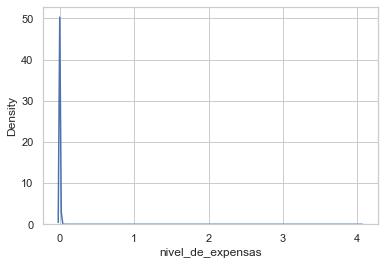

In [105]:
import seaborn as sns
sns.kdeplot(data.nivel_de_expensas)
pd.cut(nivel_expensas,8).sort_values(ascending=True).unique()

### Detección de outliers

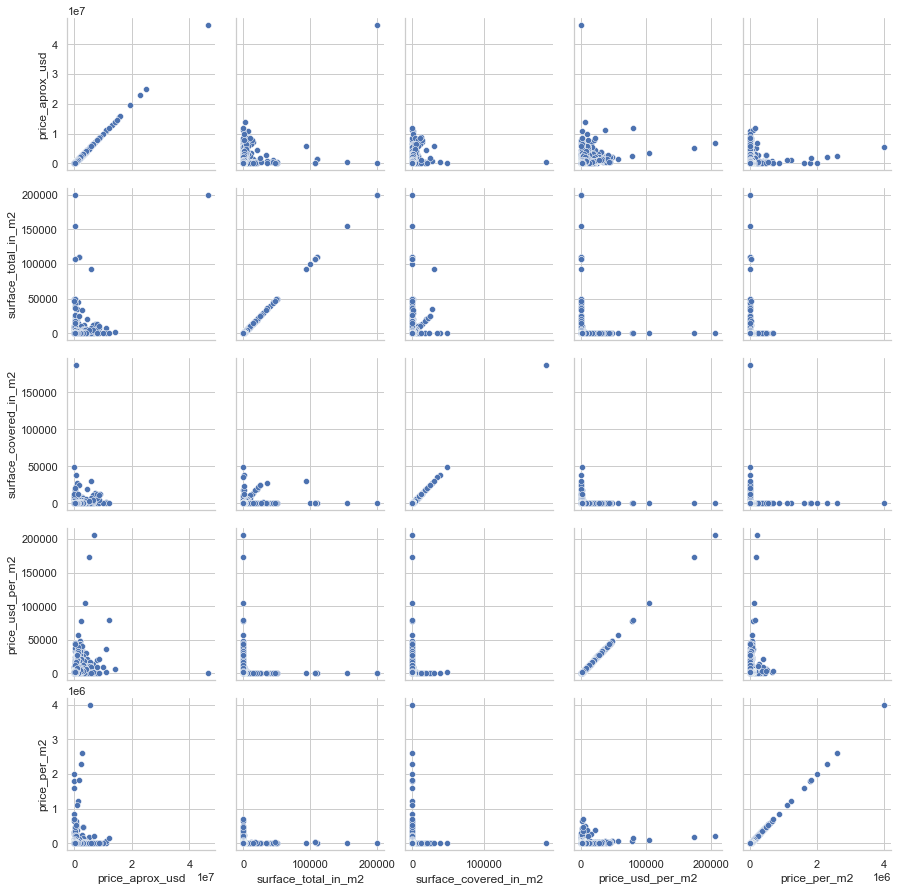

In [106]:
#grafico la relación entre distintas variables antes de limpiar las columnas
col_corr = list(data.columns[14:19])
g = sns.PairGrid(data, vars = col_corr, dropna = True)
g.map(sns.scatterplot)

#### Función para detectar outliers

Lo que sigue es un método para detectar outliers (más de 2 std, 95%) y dividir el dataset en outliers y sin-outliers, no reemplaza ni hace nada, solo los detecta|

In [107]:
#función para detectar outliers
def outliers_detection(column):
  data_mean, data_std = np.mean(column), np.std(column)
  cut_off = data_std * 2
  lower, upper = data_mean - cut_off, data_mean + cut_off
  outliers = [x for x in column if x < lower or x > upper]
  outliers_removed = [x for x in column if x >= lower and x <= upper]
  print('Identified outliers: %d' % len(outliers))
  print('Non-outlier observations: %d' % len(outliers_removed))


In [108]:
outliers_detection(data["price_aprox_usd"])

Identified outliers: 2377
Non-outlier observations: 98433


In [109]:
outliers_detection(data["price_usd_per_m2"])

Identified outliers: 1065
Non-outlier observations: 67552


## PIVOT_TABLES - ANALISIS - PRELIMPIEZA

In [110]:
#exploramos precios por state y place, para ver posibles valores de imputación
round(data.pivot_table(index='state_name', columns='property_type',
                    aggfunc={ 'price_usd_per_m2':'mean'}),2)

price_usd_per_m2                            
property_type                              PH apartment    house    store
state_name                                                               
Bs.As. G.B.A. Zona Norte              1451.71   2539.87  1339.76  1862.01
Bs.As. G.B.A. Zona Oeste              1224.02   1720.75  1081.63  1556.95
Bs.As. G.B.A. Zona Sur                1114.01   1889.98  1164.50  1541.02
Buenos Aires Costa Atlántica          1156.45   1958.84   749.15  1401.05
Buenos Aires Interior                 1019.89   1634.00   643.24   987.67
Capital Federal                       1695.52   3324.46  1546.70  2899.67
Catamarca                                 NaN       NaN   556.05      NaN
Chaco                                     NaN   1424.74   701.17  1509.55
Chubut                                    NaN   2002.69  1739.27  1323.76
Corrientes                            1478.50   1933.72  1157.18  1346.19
Córdoba                               1544.05   1426.52   713.34  1458.78
Entre Ríos                                NaN   1383.24  1119.48  1602.06
Formosa                                   NaN   1509.65      NaN      NaN
Jujuy                                     NaN   1682.51   261.93      NaN
La Pampa                                  NaN   1305.02   858.32   616.92
La Rioja                                  NaN       NaN   243.03      NaN
Mendoza                               1113.72   1966.69  1347.91  1361.58
Misiones                              1154.66   1287.52   469.74    71.60
Neuquén                               2313.92   1894.65  1138.85  1181.09
Río Negro                             1284.28   2627.96  1564.85  1504.33
Salta                                     NaN   2987.69  2128.17   179.47
San Juan                                  NaN   3191.49   105.00      NaN
San Luis                                  NaN   1724.42  1597.29  1369.95
Santa Cruz                                NaN       NaN   725.06   420.63
Santa Fe                              1207.19   2391.99   990.91  3002.90
Santiago Del Estero                       NaN    513.31   148.00      NaN
Tierra Del Fuego                          NaN   1820.55   769.87  1100.75
Tucumán                               1329.82   1495.41  1047.00   600.30

In [111]:
#exploramos precios por state y place, para ver posibles valores de imputación
round(data.pivot_table(index=['state_name','place_name'], columns='property_type',
                    aggfunc={ 'price_usd_per_m2':'mean'}),2)

price_usd_per_m2            \
property_type                                                   PH apartment   
state_name               place_name                                            
Bs.As. G.B.A. Zona Norte  Country Maschwitz Club               NaN       NaN   
                          los alamos                           NaN   1600.00   
                         Acacias Blancas                       NaN       NaN   
                         Acassuso                          1990.30   2799.08   
                         Albanueva Barrio Cerrado              NaN   2759.76   
...                                                            ...       ...   
Tucumán                  San Miguel de Tucumán             1329.82   1694.21   
                         Tafí Viejo                            NaN       NaN   
                         Tafí del Valle                        NaN       NaN   
                         Tucumán                               NaN    726.11   
                         Yerba Buena                           NaN    904.46   

                                                                     
property_type                                        house    store  
state_name               place_name                                  
Bs.As. G.B.A. Zona Norte  Country Maschwitz Club   1369.99      NaN  
                          los alamos                   NaN      NaN  
                         Acacias Blancas           1181.86      NaN  
                         Acassuso                  1596.35  2400.21  
                         Albanueva Barrio Cerrado  2359.29      NaN  
...                                                    ...      ...  
Tucumán                  San Miguel de Tucumán     1786.52   606.26  
                         Tafí Viejo                 716.98      NaN  
                         Tafí del Valle             569.48      NaN  
                         Tucumán                    522.31   469.37  
                         Yerba Buena               1061.39   694.02  

[831 rows x 4 columns]

In [112]:
#exploracion de precios, superficies y precio por m2
pd.pivot_table(data, values=["price_aprox_usd", "surface_total_in_m2", "price_per_m2"], index="state_name", aggfunc=np.mean )

,price_aprox_usd,price_per_m2,surface_total_in_m2
state_name,,,
Bs.As. G.B.A. Zona Norte,324317.123170,4887.055471,313.953244
Bs.As. G.B.A. Zona Oeste,167545.648499,3561.720169,263.217176
Bs.As. G.B.A. Zona Sur,198555.715572,4988.630332,230.557603
Buenos Aires Costa Atlántica,143430.988472,3345.592321,213.724266
Buenos Aires Interior,183249.996582,5054.261412,933.362500
Capital Federal,269603.182879,6108.161906,119.222453
Catamarca,725471.707308,3792.643567,460.285714
Chaco,178583.551389,12100.209636,290.606061
Chubut,342338.181524,4120.253214,263.452514


# **Limpieza de datos**


### Elimino registros duplicados

In [113]:
#elimino duplicados 
data.drop_duplicates(keep="first")
data.shape

,Unnamed: 0,operation,property_type,place_name,place_with_parent_names,country_name,state_name,geonames_id,lat-lon,lat,...,floor,rooms,expenses,properati_url,description,title,image_thumbnail,agrupado,tipodecambio_implicito,nivel_de_expensas
0,0,sell,PH,Mataderos,|Argentina|Capital Federal|Mataderos|,Argentina,Capital Federal,3430787.0,"-34.6618237,-58.5088387",-34.661824,...,NaN,NaN,NaN,http://www.properati.com.ar/15bo8_venta_ph_mat...,"2 AMBIENTES TIPO CASA PLANTA BAJA POR PASILLO,...",2 AMB TIPO CASA SIN EXPENSAS EN PB,https://thumbs4.properati.com/8/BluUYiHJLhgIIK...,|Argentina|Capital Federal|Mataderos|,17.6445,NaN
1,1,sell,apartment,La Plata,|Argentina|Bs.As. G.B.A. Zona Sur|La Plata|,Argentina,Bs.As. G.B.A. Zona Sur,3432039.0,"-34.9038831,-57.9643295",-34.903883,...,NaN,NaN,NaN,http://www.properati.com.ar/15bob_venta_depart...,Venta de departamento en décimo piso al frente...,VENTA Depto 2 dorm. a estrenar 7 e/ 36 y 37 ...,https://thumbs4.properati.com/7/ikpVBu2ztHA7jv...,|Argentina|Bs.As. G.B.A. Zona Sur|La Plata|,17.6445,NaN
2,2,sell,apartment,Mataderos,|Argentina|Capital Federal|Mataderos|,Argentina,Capital Federal,3430787.0,"-34.6522615,-58.5229825",-34.652262,...,NaN,NaN,NaN,http://www.properati.com.ar/15bod_venta_depart...,2 AMBIENTES 3ER PISO LATERAL LIVING COMEDOR AM...,2 AMB 3ER PISO CON ASCENSOR APTO CREDITO,https://thumbs4.properati.com/5/SXKr34F_IwG3W_...,|Argentina|Capital Federal|Mataderos|,17.6445,NaN
3,3,sell,PH,Liniers,|Argentina|Capital Federal|Liniers|,Argentina,Capital Federal,3431333.0,"-34.6477969,-58.5164244",-34.647797,...,NaN,NaN,NaN,http://www.properati.com.ar/15boh_venta_ph_lin...,PH 3 ambientes con patio. Hay 3 deptos en lote...,PH 3 amb. cfte. reciclado,https://thumbs4.properati.com/3/DgIfX-85Mog5SP...,|Argentina|Capital Federal|Liniers|,17.6445,NaN
4,4,sell,apartment,Centro,|Argentina|Buenos Aires Costa Atlántica|Mar de...,Argentina,Buenos Aires Costa Atlántica,3435548.0,"-38.0026256,-57.5494468",-38.002626,...,NaN,NaN,NaN,http://www.properati.com.ar/15bok_venta_depart...,DEPARTAMENTO CON FANTÁSTICA ILUMINACIÓN NATURA...,DEPTO 2 AMB AL CONTRAFRENTE ZONA CENTRO/PLAZA ...,https://thumbs4.properati.com/5/xrRqlNcSI_vs-f...,|Argentina|Buenos Aires Costa Atlántica|Centro|,17.6445,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
121215,121215,sell,apartment,Belgrano,|Argentina|Capital Federal|Belgrano|,Argentina,Capital Federal,3436077.0,NaN,NaN,...,NaN,NaN,10000.0,http://www.properati.com.ar/1cja2_venta_depart...,TORRE FORUM ALCORTA - MÁXIMA CATEGORÍA.Impecab...,Torre Forum Alcorta- Impecable 3 ambientes,https://thumbs4.properati.com/1/bjms0KnaAnlNoQ...,|Argentina|Capital Federal|Belgrano|,17.6445,0.000651
121216,121216,sell,house,Beccar,|Argentina|Bs.As. G.B.A. Zona Norte|San Isidro...,Argentina,Bs.As. G.B.A. Zona Norte,3436080.0,NaN,NaN,...,NaN,NaN,NaN,http://www.properati.com.ar/1cja6_venta_casa_b...,Excelente e impecable casa en Venta en Las Lom...,Ruca Inmuebles | Venta | Lomas de San Isidro |...,https://thumbs4.properati.com/2/PCc3WuQDjpNZc4...,|Argentina|Bs.As. G.B.A. Zona Norte|Beccar|,17.6445,NaN
121217,121217,sell,apartment,Villa Urquiza,|Argentina|Capital Federal|Villa Urquiza|,Argentina,Capital Federal,3433775.0,"-34.5706388726,-58.4755963355",-34.570639,...,NaN,NaN,NaN,http://www.properati.com.ar/1cja7_venta_depart...,VENTA DEPARTAMENTO AMBIENTE DIVISIBLE A ESTREN...,VENTA DEPARTAMENTO AMBIENTE DIVISIBLE A ESTREN...,https://thumbs4.properati.com/9/YAe_-2gRVykADP...,|Argentina|Capital Federal|Villa Urquiza|,17.6445,NaN
121218,121218,sell,apartment,Plaza Colón,|Argentina|Buenos Aires Costa Atlántica|Mar de...,Argentina,Buenos Aires Costa Atlántica,NaN,NaN,NaN,...,NaN,NaN,NaN,http://www.properati.com.ar/1cja8_venta_depart...,"2 Amb al contrafrente, luminoso. El departame...",2 amb. C/ dep. de servicio al contrafrente| Re...,https://thumbs4.properati.com/8/Q12PTvU6BQJ0ib...,|Argentina|Buenos Aires Costa Atlántica|Plaza ...,17.6445,NaN


(121220, 29)

### paso todo a minúscula

In [114]:
## pasar todas las columnas a minusculas
data_lower = data.applymap(lambda x: x if np.isreal(x) else str(x).lower())
# comparo los tipos de datos antes y después de pasar a minúsculas:
print(data_lower.dtypes == data.dtypes)
print(data_lower.head(3))

Unnamed: 0                    True
operation                     True
property_type                 True
place_name                    True
place_with_parent_names       True
country_name                  True
state_name                    True
geonames_id                   True
lat-lon                       True
lat                           True
lon                           True
price                         True
currency                      True
price_aprox_local_currency    True
price_aprox_usd               True
surface_total_in_m2           True
surface_covered_in_m2         True
price_usd_per_m2              True
price_per_m2                  True
floor                         True
rooms                         True
expenses                      True
properati_url                 True
description                   True
title                         True
image_thumbnail               True
agrupado                      True
tipodecambio_implicito        True
nivel_de_expensas   

### limpieza de outliers

####Método 1 sin eliminación de registros: con el siguiente método reemplazo en el dataset original los outliers de más de 2 std de todas las columnas numericas por NaN, de una vez, sin tener en cuenta las particularidades de las columnas. Como resultado obtengo un dataset del mismo tamaño que el dataset original, con los outliers convertidos en NaN para no impactar en los datos de resumen.

In [115]:
#búsqueda y reemplazo de outliers (de más de 2 std, 95%) por NaN en las columnas numéricas, en un solo paso
cols = data.select_dtypes('number').columns  # limits to a (float), b (int) and e (timedelta)
df_sub = data.loc[:, cols]
lim = np.abs((df_sub - df_sub.mean()) / df_sub.std(ddof=0)) < 2
data.loc[:, cols] = df_sub.where(lim, np.nan)
data.head(3)

,Unnamed: 0,operation,property_type,place_name,place_with_parent_names,country_name,state_name,geonames_id,lat-lon,lat,...,floor,rooms,expenses,properati_url,description,title,image_thumbnail,agrupado,tipodecambio_implicito,nivel_de_expensas
0,0,sell,PH,Mataderos,|Argentina|Capital Federal|Mataderos|,Argentina,Capital Federal,3430787.0,"-34.6618237,-58.5088387",-34.661824,...,NaN,NaN,NaN,http://www.properati.com.ar/15bo8_venta_ph_mat...,"2 AMBIENTES TIPO CASA PLANTA BAJA POR PASILLO,...",2 AMB TIPO CASA SIN EXPENSAS EN PB,https://thumbs4.properati.com/8/BluUYiHJLhgIIK...,|Argentina|Capital Federal|Mataderos|,17.6445,NaN
1,1,sell,apartment,La Plata,|Argentina|Bs.As. G.B.A. Zona Sur|La Plata|,Argentina,Bs.As. G.B.A. Zona Sur,3432039.0,"-34.9038831,-57.9643295",-34.903883,...,NaN,NaN,NaN,http://www.properati.com.ar/15bob_venta_depart...,Venta de departamento en décimo piso al frente...,VENTA Depto 2 dorm. a estrenar 7 e/ 36 y 37 ...,https://thumbs4.properati.com/7/ikpVBu2ztHA7jv...,|Argentina|Bs.As. G.B.A. Zona Sur|La Plata|,17.6445,NaN
2,2,sell,apartment,Mataderos,|Argentina|Capital Federal|Mataderos|,Argentina,Capital Federal,3430787.0,"-34.6522615,-58.5229825",-34.652262,...,NaN,NaN,NaN,http://www.properati.com.ar/15bod_venta_depart...,2 AMBIENTES 3ER PISO LATERAL LIVING COMEDOR AM...,2 AMB 3ER PISO CON ASCENSOR APTO CREDITO,https://thumbs4.properati.com/5/SXKr34F_IwG3W_...,|Argentina|Capital Federal|Mataderos|,17.6445,NaN


####Método 2 con eliminación de registros: con el siguiente método tomo en un primer paso la columna property_type, y divido por tipo de propiedad y selecciono el límite de outliers de forma individual para cada tipo de propiedad y creo nuevos dataset limpios de outliers, y luego los vuelvo a unir en un nuevo dataset (data_corr). Este nuevo dataset es considerablemente menor que el original, al haberse eliminado los registros con outliers.
En un segundo paso hago lo mismo para la columna surface_total_in_m2. Creo un nuevo dataset (data_surface_corr). Este nuevo dataset es considerablemente menor que el original, al haberse eliminado los registros con outliers.


Antes de eliminar outliers, tiro una tabla dinámica de precio por m2 en usd por tipo de propiedad y state_name

In [116]:
round(data.pivot_table(index='state_name', columns='property_type',
                    aggfunc={ 'price_usd_per_m2':'mean'}),2)

price_usd_per_m2                            
property_type                              PH apartment    house    store
state_name                                                               
Bs.As. G.B.A. Zona Norte              1405.69   2406.72  1288.83  1695.40
Bs.As. G.B.A. Zona Oeste              1144.94   1683.06   966.21  1462.81
Bs.As. G.B.A. Zona Sur                1114.01   1823.09  1144.31  1404.99
Buenos Aires Costa Atlántica          1156.45   1938.11   749.15  1401.05
Buenos Aires Interior                 1019.89   1634.00   643.24   987.67
Capital Federal                       1677.10   2721.44  1419.67  2620.17
Catamarca                                 NaN       NaN   556.05      NaN
Chaco                                     NaN   1424.74   701.17  1509.55
Chubut                                    NaN   2002.69  1592.13  1323.76
Corrientes                            1478.50   1933.72  1157.18  1346.19
Córdoba                                873.80   1418.23   698.55  1458.78
Entre Ríos                                NaN   1383.24   573.80  1602.06
Formosa                                   NaN   1509.65      NaN      NaN
Jujuy                                     NaN   1682.51   261.93      NaN
La Pampa                                  NaN   1305.02   858.32   616.92
La Rioja                                  NaN       NaN   243.03      NaN
Mendoza                               1113.72   1585.38  1070.36  1361.58
Misiones                              1154.66   1287.52   469.74    71.60
Neuquén                               2313.92   1815.42   897.42  1181.09
Río Negro                             1284.28   2627.96  1393.35  1504.33
Salta                                     NaN   1381.67   626.00   179.47
San Juan                                  NaN   3191.49   105.00      NaN
San Luis                                  NaN    850.89  1035.55  1369.95
Santa Cruz                                NaN       NaN   725.06   420.63
Santa Fe                              1207.19   1696.31   827.48  1641.52
Santiago Del Estero                       NaN    513.31   148.00      NaN
Tierra Del Fuego                          NaN   1820.55   769.87  1100.75
Tucumán                               1329.82    964.05   721.79   600.30

Ahora comienzo a eliminar los outliers por tipo de propiedad

In [117]:
# Creamos 4 datasets distintos a partir de cada tipo de propiedad (ph, departamento, casa y negocio)
data_ph, data_ap, data_ho, data_st = data.loc[data.property_type == 'PH'], data.loc[data.property_type == 'apartment'], data.loc[data.property_type == 'house'], data.loc[data.property_type == 'store']

In [118]:
# Creo un dataset corregido para los precios en dolares de ph de acuerdo a los outliers que se ven en el boxplot (90% inicial)
data_ph_corr = data_ph.loc[data_ph.price_aprox_usd <= data_ph.price_aprox_usd.quantile(0.90)]
# Ahora veo la estadística descriptiva y el cv de los datos sin outliers (90% inicial)
data_ph_corr.price_aprox_usd.describe(); print('\n')
'CV: '; data_ph_corr.price_aprox_usd.std() / data_ph_corr.price_aprox_usd.mean(); print('\n')
#sns.boxplot(data = data_ph_corr, x = 'price_aprox_usd', y = 'property_type')

# Creo un dataset corregido para los precios en dolares de ap de acuerdo a los outliers que se ven en el boxplot (90% inicial)
data_ap_corr = data_ap.loc[data_ap.price_aprox_usd <= data_ap.price_aprox_usd.quantile(0.83)]
data_ap_corr.price_aprox_usd.describe(); print('\n')
'CV: '; data_ap_corr.price_aprox_usd.std() / data_ap_corr.price_aprox_usd.mean(); print('\n')
#sns.boxplot(data = data_ap_corr, x = 'price_aprox_usd', y = 'property_type', color = 'orange')

# Creo un dataset corregido para los precios en dolares de ho de acuerdo a los outliers que se ven en el boxplot (90% inicial)
data_ho_corr = data_ho.loc[data_ho.price_aprox_usd <= data_ho.price_aprox_usd.quantile(0.91)]
data_ho_corr.price_aprox_usd.describe(); print('\n')
'CV: '; data_ho_corr.price_aprox_usd.std() / data_ho_corr.price_aprox_usd.mean(); print('\n')
#sns.boxplot(data = data_ho_corr, x = 'price_aprox_usd', y = 'property_type', color = 'green')
# ELIMINAR EL PRIMER VALOR, QUE NO PUEDE SER CERO
data_ho_corr.price_aprox_usd.sort_values()

# Creo un dataset corregido para los precios en dolares de st de acuerdo a los outliers que se ven en el boxplot (90% inicial)
data_st_corr = data_st.loc[data_st.price_aprox_usd <= data_st.price_aprox_usd.quantile(0.85)]
data_st_corr.price_aprox_usd.describe(); print('\n')
'CV:'; data_st_corr.price_aprox_usd.std() / data_st_corr.price_aprox_usd.mean(); print('\n')
#sns.boxplot(data = data_st_corr, x = 'price_aprox_usd', y = 'property_type', color = 'darkred')

count      4679.000000
mean     118314.444035
std       47644.805306
min        5047.530000
25%       80000.000000
50%      115000.000000
75%      150000.000000
max      240000.000000
Name: price_aprox_usd, dtype: float64

'CV: '

0.4026964390923061

count     48959.000000
mean     112419.808634
std       49142.496744
min        4666.620000
25%       75000.000000
50%      100950.610000
75%      143000.000000
max      240000.000000
Name: price_aprox_usd, dtype: float64

'CV: '

0.4371337875506749

count     28731.000000
mean     231809.540589
std      126815.660268
min           0.000000
25%      130000.000000
50%      210000.000000
75%      320000.000000
max      552000.000000
Name: price_aprox_usd, dtype: float64

'CV: '

0.5470683387136214

9761           0.00
104072      5047.53
40583       5776.61
116091      6169.20
112899      6231.51
            ...    
37398     550000.00
27236     550000.00
56626     550000.00
73271     550400.00
59081     552000.00
Name: price_aprox_usd, Length: 28731, dtype: float64

count      2511.000000
mean     180400.514174
std      124826.096933
min        4952.450000
25%       75738.975000
50%      150000.000000
75%      260000.000000
max      490000.000000
Name: price_aprox_usd, dtype: float64

'CV:'

0.6919386982058691

In [119]:
# creo un nuevo dataset con los dataset por tipo de propiedad concatenados
data_corr = pd.concat([data_ph_corr, data_ap_corr, data_st_corr,  data_ho_corr])
data_corr.shape

(84880, 29)

Genero una nueva tabla dinámica con los valores de precio por m2 en usd con los datos sin outliers (debo tener en cuenta que pasamos de tener 120.000 registros a tener 87.000, cosa que no sé si es admisible)

In [120]:
round(data_corr.pivot_table(index='state_name', columns='property_type',
                    aggfunc={ 'price_usd_per_m2':'mean'}),2)

price_usd_per_m2                            
property_type                              PH apartment    house    store
state_name                                                               
Bs.As. G.B.A. Zona Norte              1384.74   2157.91  1151.15  1753.42
Bs.As. G.B.A. Zona Oeste              1141.32   1660.00   937.63  1486.88
Bs.As. G.B.A. Zona Sur                1097.52   1762.82  1083.24  1357.09
Buenos Aires Costa Atlántica          1137.11   1876.75   736.81  1415.69
Buenos Aires Interior                 1019.89   1623.02   612.77   974.93
Capital Federal                       1670.92   2451.82  1336.20  2434.53
Catamarca                                 NaN       NaN   556.05      NaN
Chaco                                     NaN   1264.47   701.17      NaN
Chubut                                    NaN   1800.92  1575.66  1264.58
Corrientes                            1337.47   1902.18  1147.54  1381.19
Córdoba                                873.07   1401.26   641.65  1458.50
Entre Ríos                                NaN   1368.42   573.80  1007.27
Formosa                                   NaN   1509.65      NaN      NaN
Jujuy                                     NaN   1682.51   210.31      NaN
La Pampa                                  NaN   1305.02   858.32   616.92
La Rioja                                  NaN       NaN   243.03      NaN
Mendoza                                900.00   1577.64   878.59  1383.94
Misiones                              1154.66   1288.17   459.63     9.88
Neuquén                               2313.66   1800.20   900.32  1637.02
Río Negro                             1284.28   1817.51  1277.01  1317.84
Salta                                     NaN   1353.70   555.04   179.47
San Juan                                  NaN       NaN   105.00      NaN
San Luis                                  NaN    902.53   741.58  1284.39
Santa Cruz                                NaN       NaN   725.06   420.63
Santa Fe                              1204.61   1655.64   776.01  1719.89
Santiago Del Estero                       NaN    513.31   148.00      NaN
Tierra Del Fuego                          NaN   1527.39   769.87  1001.49
Tucumán                               1329.82    952.28   646.50   600.30

In [121]:
## SUFARCE_CORREGIDO PARA PH
# Creo un dataset corregido para los precios en dolares de ph de acuerdo a los outliers que se ven en el boxplot (89% inicial)
data_ph_corr_surface = data_ph.loc[data_ph.surface_total_in_m2 <= data_ph.surface_total_in_m2.quantile(0.89)]
# Ahora veo la estadística descriptiva y el cv de los datos sin outliers (90% inicial)
data_ph_corr_surface.surface_total_in_m2.describe(); print('\n')
'CV: '; data_ph_corr_surface.surface_total_in_m2.std() / data_ph_corr_surface.surface_total_in_m2.mean(); print('\n')

## SUFARCE_CORREGIDO PARA AP
# Creo un dataset corregido para los precios en dolares de ph de acuerdo a los outliers que se ven en el boxplot (88% inicial)
data_ap_corr_surface = data_ap.loc[data_ap.surface_total_in_m2 <= data_ap.surface_total_in_m2.quantile(0.88)]
# Ahora veo la estadística descriptiva y el cv de los datos sin outliers (90% inicial)
data_ap_corr_surface.surface_total_in_m2.describe(); print('\n')
'CV: '; data_ap_corr_surface.surface_total_in_m2.std() / data_ap_corr_surface.surface_total_in_m2.mean(); print('\n')

## SUFARCE_CORREGIDO PARA ho
# Creo un dataset corregido para los precios en dolares de ph de acuerdo a los outliers que se ven en el boxplot (81% inicial)
data_ho_corr_surface = data_ho.loc[data_ho.surface_total_in_m2 <= data_ho.surface_total_in_m2.quantile(0.81)]
# Ahora veo la estadística descriptiva y el cv de los datos sin outliers (90% inicial)
data_ho_corr_surface.surface_total_in_m2.describe(); print('\n')
'CV: '; data_ho_corr_surface.surface_total_in_m2.std() / data_ho_corr_surface.surface_total_in_m2.mean(); print('\n')

## SUFARCE_CORREGIDO PARA store
# Creo un dataset corregido para los precios en dolares de ph de acuerdo a los outliers que se ven en el boxplot (80% inicial)
data_st_corr_surface = data_st.loc[data_st.surface_total_in_m2 <= data_st.surface_total_in_m2.quantile(0.80)]
# Ahora veo la estadística descriptiva y el cv de los datos sin outliers (90% inicial)
data_st_corr_surface.surface_total_in_m2.describe(); print('\n')
'CV: '; data_st_corr_surface.surface_total_in_m2.std() / data_st_corr_surface.surface_total_in_m2.mean(); print('\n')


count    3210.000000
mean       92.940498
std        42.718672
min         0.000000
25%        60.000000
50%        84.000000
75%       120.000000
max       200.000000
Name: surface_total_in_m2, dtype: float64

'CV: '

0.45963462909314307

count    44948.000000
mean        59.644634
std         23.970404
min          0.000000
25%         41.000000
50%         54.000000
75%         75.000000
max        123.000000
Name: surface_total_in_m2, dtype: float64

'CV: '

0.40188701330239524

count    19691.000000
mean       253.095881
std        124.432369
min          0.000000
25%        160.000000
50%        235.000000
75%        330.000000
max        588.000000
Name: surface_total_in_m2, dtype: float64

'CV: '

0.491641226277846

count    2119.000000
mean      139.063709
std       107.253608
min         0.000000
25%        47.000000
50%       106.000000
75%       209.000000
max       429.000000
Name: surface_total_in_m2, dtype: float64

'CV: '

0.7712551908462554

In [122]:
# creo un nuevo dataset con los dataset por surface_total concatenados
data_surface_corr = pd.concat([data_ph_corr_surface, data_ap_corr_surface, data_st_corr_surface,  data_st_corr_surface])
data_surface_corr.shape

(52396, 29)

pasamos de un dataset con 120.000 a uno de 52000 registros limpios por la columna surface

# **Imputaciones**


### Columnas lat y lon: 
hago un merge entre data y dataAR para completar los valores de lat y lon en el caso que se pueda (acá genero un nuevo dataset data_dataAR, podría ver de hacerlo en el mismo y seguir teniendo data como dataset).

In [123]:
#chequeo la cantidad de nulls en las columnas lat y lon
print(data["lat"].isnull().sum())
print(data["lon"].isnull().sum())

53946
58491


In [124]:
#hago un merge entre el dataset de properati y dataAR creando un nuevo dataset
data_AR = pd.merge(data, dataAR, how="left")
print(data_AR.shape)
print(data_AR.columns)

(121633, 33)
Index(['Unnamed: 0', 'operation', 'property_type', 'place_name',
       'place_with_parent_names', 'country_name', 'state_name', 'geonames_id',
       'lat-lon', 'lat', 'lon', 'price', 'currency',
       'price_aprox_local_currency', 'price_aprox_usd', 'surface_total_in_m2',
       'surface_covered_in_m2', 'price_usd_per_m2', 'price_per_m2', 'floor',
       'rooms', 'expenses', 'properati_url', 'description', 'title',
       'image_thumbnail', 'agrupado', 'tipodecambio_implicito',
       'nivel_de_expensas', 'place_name2', 'Lat', 'Lon', 'Pais'],
      dtype='object')


In [125]:
#relleno los nulls de lat y lon en properati, con los valores de Lat y Lon traídas del dataset nuevo 
data["lat"].fillna(dataAR["Lat"], inplace=True)
data["lon"].fillna(dataAR["Lon"], inplace=True)


In [126]:
#chequeo nuevamente nulls en lat y lon
print(data["lat"].isnull().sum())
print(data["lon"].isnull().sum())

43821
45898


In [127]:
data.columns

Index(['Unnamed: 0', 'operation', 'property_type', 'place_name',
       'place_with_parent_names', 'country_name', 'state_name', 'geonames_id',
       'lat-lon', 'lat', 'lon', 'price', 'currency',
       'price_aprox_local_currency', 'price_aprox_usd', 'surface_total_in_m2',
       'surface_covered_in_m2', 'price_usd_per_m2', 'price_per_m2', 'floor',
       'rooms', 'expenses', 'properati_url', 'description', 'title',
       'image_thumbnail', 'agrupado', 'tipodecambio_implicito',
       'nivel_de_expensas'],
      dtype='object')

### completo valores de rooms con información del title, o properati_url o description

será posible sacar el número de rooms del titulo de la publicación? cuando haya datos de la cantidad de ambientes? sabiendo que rooms = ambientes - 1

In [128]:
#exploro tipo de datos de la columnas
data["title"].unique()

array(['2 AMB TIPO CASA SIN EXPENSAS EN PB',
       'VENTA Depto 2 dorm. a estrenar 7 e/ 36 y 37               ',
       '2 AMB 3ER PISO CON ASCENSOR APTO CREDITO', ...,
       'Torre Forum Alcorta- Impecable 3 ambientes',
       'VENTA DEPARTAMENTO AMBIENTE DIVISIBLE A ESTRENAR BALCON AMENITIES.',
       'Departamento apto profesional en el Centro'], dtype=object)

In [129]:
# busco el patrón numero espacio "amb" o "AMB" en la columna title y reemplazo el número obtenido menos 1 en la columna rooms
import re
patron = "(?P<numero>\d+)(\s+)(AMB*|amb*)"
regex = re.compile(patron)
serie = data.title
resultado = serie.apply(lambda x: regex.match(x))
#resultado.unique()

ambientes = resultado.apply(lambda x: x if x is None else x.group('numero'))
ambientes_regex = ambientes.astype(float) -1
data["rooms"].fillna(ambientes_regex, inplace=True)
data["rooms"].isnull().sum()

75081

In [130]:
#creo un nuevo patrón para dormitorio, en la columna description y reemplazo el número obtenido en la columna rooms
patron2 = "(?P<numero>\d+)(\s+)(DORM*|dorm*)"
regex2 = re.compile(patron2)
serie2 = data.description
resultado2 = serie.apply(lambda x: regex2.match(x))
#resultado2.unique()

dormitorios = resultado2.apply(lambda x: x if x is None else x.group('numero'))
dormitorios_regex= dormitorios.astype(float)
data["rooms"].fillna(dormitorios_regex, inplace=True)
data["rooms"].isnull().sum()

74962

Resultado: no mejoran considerablemente la cantidad de nulos completados. Hay que ver si es error de expresión regular u otro motivo.

## Imputación de price_usd_per_m2 usando medianas sacadas con groupby de lugares y tipo de propiedad

In [131]:
# Creo tantas variables como niveles tiene la columna place_with_parent_names procurando no meter valores vacíos tipo '' o ' '. 
#En cada columna pongo nan (np.NaN) si no hay valor en ese nivel.
pais = data.place_with_parent_names.apply(lambda x: x.split('|')[1] if (len(x.split('|')) >= 2 and x.split('|')[1] != '') else np.NaN)
provincia = data.place_with_parent_names.apply(lambda x: x.split('|')[2] if (len(x.split('|')) >= 3 and x.split('|')[2] != '') else np.NaN)
localidad = data.place_with_parent_names.apply(lambda x: x.split('|')[3] if (len(x.split('|')) >= 4 and x.split('|')[3] != '') else np.NaN)
barrio = data.place_with_parent_names.apply(lambda x: x.split('|')[4] if (len(x.split('|')) >= 5 and x.split('|')[4] != '') else np.NaN)
barrio_1 = data.place_with_parent_names.apply(lambda x: x.split('|')[5] if (len(x.split('|')) >= 6 and x.split('|')[5] != '') else np.NaN)

# Chequeo si las columnas nativas son iguales a las creadas de nuevo, al menos las superiores
(data.country_name != pais).sum()
(data.state_name != provincia).sum()

# Para las columnas que no son iguales o no tienen contraparte (place_name tiene la granularidad más fina por observación, con una mezcla de provincias, localidades y barrios) 
#hago la suma de sus componentes para ver si completamos el total de observaciones (121220).
provincia.loc[localidad.isnull()].notnull().sum() + localidad.loc[barrio.isnull()].notnull().sum() + barrio.loc[barrio_1.isnull()].notnull().sum() + barrio_1.notnull().sum() - len(data)

# Chequeo que place_name tampoco tenga nulos.
data.place_name.isnull().sum()

# Como sí tiene, miro cuáles son y con qué debería estar completo
data.loc[data.place_name.isnull()].head(3)

0

0

0

23

,Unnamed: 0,operation,property_type,place_name,place_with_parent_names,country_name,state_name,geonames_id,lat-lon,lat,...,floor,rooms,expenses,properati_url,description,title,image_thumbnail,agrupado,tipodecambio_implicito,nivel_de_expensas
6489,6489,sell,house,NaN,|Argentina|Bs.As. G.B.A. Zona Norte|Tigre||,Argentina,Bs.As. G.B.A. Zona Norte,NaN,"-34.4008968545,-58.63809847",-34.400897,...,NaN,NaN,NaN,http://www.properati.com.ar/15ui7_venta_casa_t...,"Espectacular casa moderna de una planta, con a...",Venta de casa en Santa María de Tigre,https://thumbs4.properati.com/7/vQjgbHSz1fKXxy...,NaN,17.6445,NaN
10201,10201,sell,house,NaN,|Argentina|Bs.As. G.B.A. Zona Norte|Tigre||,Argentina,Bs.As. G.B.A. Zona Norte,NaN,"-34.400704,-58.638067",-34.400704,...,NaN,5.0,NaN,http://www.properati.com.ar/166p5_venta_casa_t...,Corredor Responsable: SABRINA COCCONI - CSI 62...,VENTA CASA SANTA MARÍA DE TIGRE COUNTRY BARRIO...,https://thumbs4.properati.com/1/FABpKIJMaoAO3t...,NaN,17.6445,NaN
11451,11451,sell,house,NaN,|Argentina|Bs.As. G.B.A. Zona Norte|Tigre||,Argentina,Bs.As. G.B.A. Zona Norte,NaN,"-34.4026880384,-58.6262613379",-34.402688,...,NaN,NaN,NaN,http://www.properati.com.ar/16bpd_venta_casa_t...,MUY LINDA CASA EN EXCELENTE UBICACION!! Superf...,SANTA MARIA DE TIGRE IMPECABLE,https://thumbs4.properati.com/5/fwH9L71hW2rW7V...,NaN,17.6445,NaN


In [132]:
# Agrego las columnas de lugares desagregados al dataframe original
data['s_pais'], data['s_provincia'], data['s_localidad'], data['s_barrio'], data['s_barrio_1'] = pais, provincia, localidad, barrio, barrio_1

In [133]:
# Chequeo que todo lo que hay en place_name esté en las nuevas columnas accesorias
data.place_name.loc[data.apply(lambda x: np.NaN if x['place_name'] == x['s_barrio_1'] else (np.NaN if x['place_name'] == x['s_barrio'] else (np.NaN if x['place_name'] == x['s_localidad'] else (np.NaN if x['place_name'] == x['s_provincia'] else x['place_name']))), axis = 1).notnull()]

Series([], Name: place_name, dtype: object)

In [134]:
# Creo una nueva columna que tenga lo más fino de los lugares por observación, en parte para imputar los nans de place_name, y en parte para corroborar que place_name tenga en realidad lo más fino y no algún nivel superior
data['s_place_name'] = data.apply(lambda x: x['s_barrio_1'] if x['s_barrio_1'] is not np.NaN else (x['s_barrio'] if x['s_barrio'] is not np.NaN else (x['s_localidad'] if x['s_localidad'] is not np.NaN else (x['s_provincia'] if x['s_provincia'] is not np.NaN else x['pais']))), axis = 1)

In [135]:
# Chequeo si la columna recién creada tiene algú null
data['s_place_name'].isnull().sum()
# Ahora chequeo cuántas diferencias tiene con place_name
(data['s_place_name'] != data['place_name']).sum()
# Con esto vemos que sólo diferían en los nulos y que ahora fueron completados. Veamos si los completamos bien (deberían decir 'Tigre')
data[['place_name', 'place_with_parent_names', 's_place_name']].loc[data.place_name.isnull()]

0

23

,place_name,place_with_parent_names,s_place_name
6489,NaN,|Argentina|Bs.As. G.B.A. Zona Norte|Tigre||,Tigre
10201,NaN,|Argentina|Bs.As. G.B.A. Zona Norte|Tigre||,Tigre
11451,NaN,|Argentina|Bs.As. G.B.A. Zona Norte|Tigre||,Tigre
14839,NaN,|Argentina|Bs.As. G.B.A. Zona Norte|Tigre||,Tigre
18622,NaN,|Argentina|Bs.As. G.B.A. Zona Norte|Tigre||,Tigre
21922,NaN,|Argentina|Bs.As. G.B.A. Zona Norte|Tigre||,Tigre
23664,NaN,|Argentina|Bs.As. G.B.A. Zona Norte|Tigre||,Tigre
24722,NaN,|Argentina|Bs.As. G.B.A. Zona Norte|Tigre||,Tigre
38856,NaN,|Argentina|Bs.As. G.B.A. Zona Norte|Tigre||,Tigre
45970,NaN,|Argentina|Bs.As. G.B.A. Zona Norte|Tigre||,Tigre


In [136]:
# Creo los dataframes agrupados por lugar y tipo de propiedad para luego hacer los merges
data_grp_b1 = data.groupby(['s_barrio_1', 'property_type'])['price_usd_per_m2'].median().reset_index()
data_grp_b = data.groupby(['s_barrio', 'property_type'])['price_usd_per_m2'].median().reset_index()
data_grp_l = data.groupby(['s_localidad', 'property_type'])['price_usd_per_m2'].median().reset_index()
data_grp_p = data.groupby(['s_provincia', 'property_type'])['price_usd_per_m2'].median().reset_index()

In [137]:
# mergeo el dataset original con los dataframes agrupados creando cada vez una columna nueva con las medianas por lugar desde lo más fino (barrio_1 o b1) hasta lo más grueso (provincia o p)

# merge barrio_1
data_merge = pd.merge(data, data_grp_b1, left_on = ["s_barrio_1","property_type"], right_on = ["s_barrio_1","property_type"], how = "left", suffixes = ('', '_b1'))

# merge barrio 
data_merge = pd.merge(data_merge, data_grp_b, left_on = ["s_barrio","property_type"], right_on = ["s_barrio","property_type"], how = "left", suffixes = ('', '_b'))

# merge localidad 
data_merge = pd.merge(data_merge, data_grp_l, left_on = ["s_localidad","property_type"], right_on = ["s_localidad","property_type"], how = "left", suffixes = ('', '_l'))

# merge provincia 
data_merge = pd.merge(data_merge, data_grp_p, left_on = ["s_provincia","property_type"], right_on = ["s_provincia","property_type"], how = "left", suffixes = ('', '_p'))

data_merge.head(3)

,Unnamed: 0,operation,property_type,place_name,place_with_parent_names,country_name,state_name,geonames_id,lat-lon,lat,...,s_pais,s_provincia,s_localidad,s_barrio,s_barrio_1,s_place_name,price_usd_per_m2_b1,price_usd_per_m2_b,price_usd_per_m2_l,price_usd_per_m2_p
0,0,sell,PH,Mataderos,|Argentina|Capital Federal|Mataderos|,Argentina,Capital Federal,3430787.0,"-34.6618237,-58.5088387",-34.661824,...,Argentina,Capital Federal,Mataderos,NaN,NaN,Mataderos,NaN,NaN,1274.920635,1625.000000
1,1,sell,apartment,La Plata,|Argentina|Bs.As. G.B.A. Zona Sur|La Plata|,Argentina,Bs.As. G.B.A. Zona Sur,3432039.0,"-34.9038831,-57.9643295",-34.903883,...,Argentina,Bs.As. G.B.A. Zona Sur,La Plata,NaN,NaN,La Plata,NaN,NaN,1711.540658,1818.181818
2,2,sell,apartment,Mataderos,|Argentina|Capital Federal|Mataderos|,Argentina,Capital Federal,3430787.0,"-34.6522615,-58.5229825",-34.652262,...,Argentina,Capital Federal,Mataderos,NaN,NaN,Mataderos,NaN,NaN,1830.320421,2530.120482


In [138]:
# Ahora creo la nueva columna de inputación de precios en dólares por m2 poniendo el valor original si existe (price_usd_per_m2) o la inputación más fina que tengamos (barrio_1 si no es nan, si no barrio si no es nan, si no localidad si no es nan, y si no provincia)
data_merge['input_price_usd_m2'] = data_merge.apply(lambda x: x['price_usd_per_m2'] if pd.notna(x['price_usd_per_m2']) else (x['price_usd_per_m2_b1'] if pd.notna(x['price_usd_per_m2_b1']) else (x['price_usd_per_m2_b'] if pd.notna(x['price_usd_per_m2_b']) else (x['price_usd_per_m2_l'] if pd.notna(x['price_usd_per_m2_l']) else x['price_usd_per_m2_p']))), axis = 1)
data_merge.head(3)

,Unnamed: 0,operation,property_type,place_name,place_with_parent_names,country_name,state_name,geonames_id,lat-lon,lat,...,s_provincia,s_localidad,s_barrio,s_barrio_1,s_place_name,price_usd_per_m2_b1,price_usd_per_m2_b,price_usd_per_m2_l,price_usd_per_m2_p,input_price_usd_m2
0,0,sell,PH,Mataderos,|Argentina|Capital Federal|Mataderos|,Argentina,Capital Federal,3430787.0,"-34.6618237,-58.5088387",-34.661824,...,Capital Federal,Mataderos,NaN,NaN,Mataderos,NaN,NaN,1274.920635,1625.000000,1127.272727
1,1,sell,apartment,La Plata,|Argentina|Bs.As. G.B.A. Zona Sur|La Plata|,Argentina,Bs.As. G.B.A. Zona Sur,3432039.0,"-34.9038831,-57.9643295",-34.903883,...,Bs.As. G.B.A. Zona Sur,La Plata,NaN,NaN,La Plata,NaN,NaN,1711.540658,1818.181818,1711.540658
2,2,sell,apartment,Mataderos,|Argentina|Capital Federal|Mataderos|,Argentina,Capital Federal,3430787.0,"-34.6522615,-58.5229825",-34.652262,...,Capital Federal,Mataderos,NaN,NaN,Mataderos,NaN,NaN,1830.320421,2530.120482,1309.090909


In [139]:
# Dropeo las columnas accesorias que no suman info al dataset general
data_merge.drop(labels = ['s_pais', 's_provincia', 's_localidad', 's_barrio', 's_barrio_1', 's_place_name', 'price_usd_per_m2_b1', 'price_usd_per_m2_b', 'price_usd_per_m2_l', 'price_usd_per_m2_p'], axis = 1, inplace = True)
data_merge.head(3)

,Unnamed: 0,operation,property_type,place_name,place_with_parent_names,country_name,state_name,geonames_id,lat-lon,lat,...,rooms,expenses,properati_url,description,title,image_thumbnail,agrupado,tipodecambio_implicito,nivel_de_expensas,input_price_usd_m2
0,0,sell,PH,Mataderos,|Argentina|Capital Federal|Mataderos|,Argentina,Capital Federal,3430787.0,"-34.6618237,-58.5088387",-34.661824,...,1.0,NaN,http://www.properati.com.ar/15bo8_venta_ph_mat...,"2 AMBIENTES TIPO CASA PLANTA BAJA POR PASILLO,...",2 AMB TIPO CASA SIN EXPENSAS EN PB,https://thumbs4.properati.com/8/BluUYiHJLhgIIK...,|Argentina|Capital Federal|Mataderos|,17.6445,NaN,1127.272727
1,1,sell,apartment,La Plata,|Argentina|Bs.As. G.B.A. Zona Sur|La Plata|,Argentina,Bs.As. G.B.A. Zona Sur,3432039.0,"-34.9038831,-57.9643295",-34.903883,...,NaN,NaN,http://www.properati.com.ar/15bob_venta_depart...,Venta de departamento en décimo piso al frente...,VENTA Depto 2 dorm. a estrenar 7 e/ 36 y 37 ...,https://thumbs4.properati.com/7/ikpVBu2ztHA7jv...,|Argentina|Bs.As. G.B.A. Zona Sur|La Plata|,17.6445,NaN,1711.540658
2,2,sell,apartment,Mataderos,|Argentina|Capital Federal|Mataderos|,Argentina,Capital Federal,3430787.0,"-34.6522615,-58.5229825",-34.652262,...,1.0,NaN,http://www.properati.com.ar/15bod_venta_depart...,2 AMBIENTES 3ER PISO LATERAL LIVING COMEDOR AM...,2 AMB 3ER PISO CON ASCENSOR APTO CREDITO,https://thumbs4.properati.com/5/SXKr34F_IwG3W_...,|Argentina|Capital Federal|Mataderos|,17.6445,NaN,1309.090909


In [140]:
# Porcentaje de nan en los precios por m2 en dólares imputados
data_merge.input_price_usd_m2.isnull().sum() / len(data_merge) * 100

# Describe
data_merge.input_price_usd_m2.describe()

# Coeficiente de variación
data_merge.input_price_usd_m2.std() / data_merge.input_price_usd_m2.mean()

0.03877247978881373

count    121173.000000
mean       1735.491729
std         950.714868
min           0.600000
25%        1136.363636
50%        1662.480357
75%        2200.000000
max        7674.418605
Name: input_price_usd_m2, dtype: float64

0.5478072020985386

# **Nueva exploración post - limpieza/imputación**

esta exploración nueva es sobre el dataset DATA que tiene el método de eliminación de outliers de 1.75 desviaciones estándares (90%) a todas las columnas numéricas.
Los dataset resultado de eliminar los outliers de las columnas price_usd_per_m2 y surface_total_m2 son datasets distintos (data_corr y data_surface_corr). 

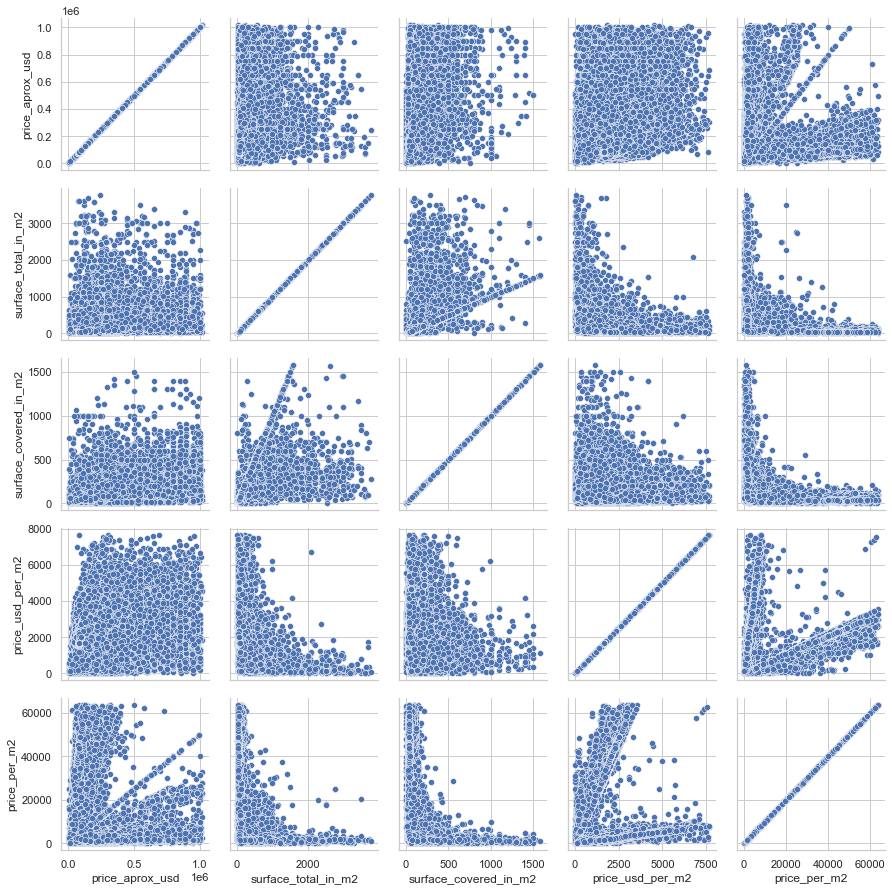

In [141]:
#nuevos graficos sin outliers
col_corr = list(data.columns[14:19])
g = sns.PairGrid(data, vars = col_corr, dropna = True)
g.map(sns.scatterplot)

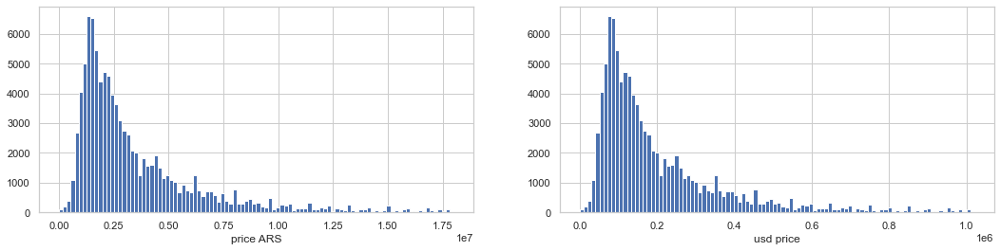

In [142]:
#comparo la distribución de price vs price_aprox_usd sin outliers (calculados al 95% - 2 std)
fig, ax = plt.subplots(ncols = 2, figsize = (18, 4))
_ =ax[0].hist(data['price_aprox_local_currency'], bins=100)
_ =ax[0].set_xlabel('price ARS')
_ =ax[1].hist(data['price_aprox_usd'], bins=100)
_ =ax[1].set_xlabel('usd price')
plt.show()

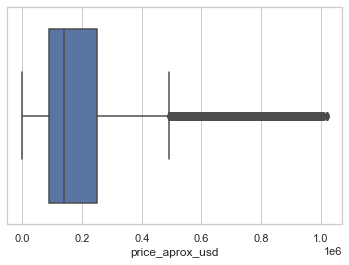

In [143]:
#grafico price_aprox_local_currency y price_aprox_usd post limpieza
#sns.boxplot(x='price_aprox_local_currency', data=data)
sns.boxplot(x='price_aprox_usd', data=data)

count    67552.000000
mean      1894.113255
std       1059.591735
min          0.600000
25%       1206.374536
50%       1785.714286
75%       2441.189853
max       7674.418605
Name: price_usd_per_m2, dtype: float64

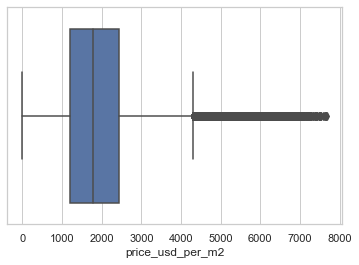

In [144]:
#grafico price_usd_per_m2 post limpieza
sns.set_theme(style="whitegrid")
ax = sns.boxplot(x=data['price_usd_per_m2'])

data.price_usd_per_m2.describe()


count    81621.000000
mean       183.814202
std        285.720725
min          0.000000
25%         50.000000
50%         83.000000
75%        200.000000
max       3780.000000
Name: surface_total_in_m2, dtype: float64

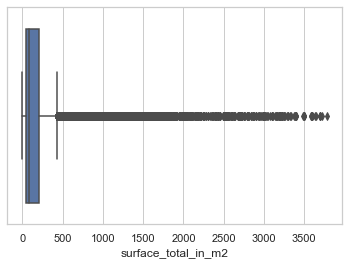

In [145]:
sns.set_theme(style="whitegrid")
ax = sns.boxplot(x=data['surface_total_in_m2'])

data.surface_total_in_m2.describe()
#seguimos teniendo muchos outliers, por eso mejor aplicar el método personalizado de eliminación de outliers por tipo de propiedad para esta columna

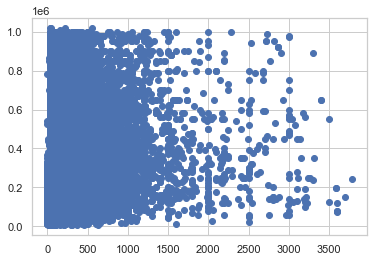

In [146]:
#creo scatterplot de surface total y price_aprox_usd post limpieza
plt.scatter(data['surface_total_in_m2'],data['price_aprox_usd'])
plt.show()

## **Pivot tables**

Hacemos distintas agrupaciones para responder preguntas (por ejemplo: qué barrio de CABA tiene el metro cuadrado más caro?)
Usamos el dataset data_corr que no tiene outliers (menos cantidad de registros)

In [147]:
#calculamos el precio promedio por metro cuadrado en dolares por Barrio en CABA usando el dataset data_corr que tiene los datos corregidos (sin outliers)
#por tipo de propiedad
mask = data["state_name"] == "Capital Federal"
data_CABA = data[mask]
round(data_CABA.pivot_table(index=['place_name'],aggfunc={ 'price_usd_per_m2':'median'}),2).sort_values(by="price_usd_per_m2", ascending=False)

,price_usd_per_m2
place_name,
Puerto Madero,5667.98
Palermo Chico,4216.22
Las Cañitas,3342.28
Recoleta,3119.04
Palermo,3062.92
...,...
Velez Sarsfield,1274.34
Villa Riachuelo,1229.51
Villa Lugano,1100.00


In [148]:
#hacemos una tabla dinámica del precio por metro cuadrado promedio por tipo de propiedad y por localidad/barrio
round(data.pivot_table(index=['state_name','place_name'], columns='property_type',
                    aggfunc={ 'price_usd_per_m2':'median'}),2)

price_usd_per_m2            \
property_type                                                   PH apartment   
state_name               place_name                                            
Bs.As. G.B.A. Zona Norte  Country Maschwitz Club               NaN       NaN   
                          los alamos                           NaN   1600.00   
                         Acacias Blancas                       NaN       NaN   
                         Acassuso                          2331.03   2617.65   
                         Albanueva Barrio Cerrado              NaN   2785.71   
...                                                            ...       ...   
Tucumán                  San Miguel de Tucumán             1329.82    805.45   
                         Tafí Viejo                            NaN       NaN   
                         Tafí del Valle                        NaN       NaN   
                         Tucumán                               NaN    592.32   
                         Yerba Buena                           NaN   1184.82   

                                                                     
property_type                                        house    store  
state_name               place_name                                  
Bs.As. G.B.A. Zona Norte  Country Maschwitz Club   1369.99      NaN  
                          los alamos                   NaN      NaN  
                         Acacias Blancas           1307.69      NaN  
                         Acassuso                  1398.37  2027.03  
                         Albanueva Barrio Cerrado  2574.75      NaN  
...                                                    ...      ...  
Tucumán                  San Miguel de Tucumán      625.55   554.32  
                         Tafí Viejo                 716.98      NaN  
                         Tafí del Valle             486.87      NaN  
                         Tucumán                    458.33   506.78  
                         Yerba Buena                934.73   529.58  

[829 rows x 4 columns]

In [149]:
#EXPLORACION PRECIOS EN DOLARES POR M2, POR PROVINCIA
round(data.pivot_table(index='state_name', columns='property_type',
                    aggfunc={ 'price_usd_per_m2':'median'}),2)

price_usd_per_m2                            
property_type                              PH apartment    house    store
state_name                                                               
Bs.As. G.B.A. Zona Norte              1324.26   2292.84  1280.00  1409.64
Bs.As. G.B.A. Zona Oeste              1100.85   1666.67   855.92  1106.06
Bs.As. G.B.A. Zona Sur                1067.52   1818.18  1124.26  1049.48
Buenos Aires Costa Atlántica          1111.11   1897.50   611.92  1250.00
Buenos Aires Interior                  971.50   1631.58   484.41   837.29
Capital Federal                       1625.00   2530.12  1260.87  2270.27
Catamarca                                 NaN       NaN   376.14      NaN
Chaco                                     NaN   1709.87   747.78  1509.55
Chubut                                    NaN   2062.50  1400.00  1107.10
Corrientes                            1357.14   1857.67  1111.11  1294.82
Córdoba                                950.57   1418.18   570.39  1345.03
Entre Ríos                                NaN   1450.44   399.60  1007.27
Formosa                                   NaN   1513.74      NaN      NaN
Jujuy                                     NaN   1682.51   280.27      NaN
La Pampa                                  NaN   1305.02   855.94   616.92
La Rioja                                  NaN       NaN   243.03      NaN
Mendoza                               1113.72   1568.81   971.35  1720.89
Misiones                              1154.66   1342.15   284.95    71.60
Neuquén                               2557.11   1850.72   742.93   800.00
Río Negro                             1682.35   2500.00  1250.00  1300.32
Salta                                     NaN   1504.09   568.12   179.47
San Juan                                  NaN   3191.49   105.00      NaN
San Luis                                  NaN   1035.39   756.30  1150.44
Santa Cruz                                NaN       NaN   565.74   420.63
Santa Fe                              1246.30   1650.68   686.47  1537.76
Santiago Del Estero                       NaN    513.31   148.00      NaN
Tierra Del Fuego                          NaN   1316.18   808.22  1100.75
Tucumán                               1329.82    785.17   598.23   530.55

Creo un dataset de AMBA para hacer el filtro por place name y tipo de propiedad solo de esa zona

In [150]:
#seleccionar propiedades de CABA y GBA
AMBA = ['Capital Federal', 'Bs.As. G.B.A. Zona Sur', 'Bs.As. G.B.A. Zona Norte','Bs.As. G.B.A. Zona Norte']
data_AMBA = data[(data["state_name"]== 'Capital Federal') | (data["state_name"]== 'Bs.As. G.B.A. Zona Sur') | (data["state_name"]=='Bs.As. G.B.A. Zona Norte') | (data["state_name"]== 'Bs.As. G.B.A. Zona Norte')]
print(data_AMBA.shape)
print(data_AMBA.head(3))

(71828, 35)
   Unnamed: 0 operation property_type place_name  \
0           0      sell            PH  Mataderos   
1           1      sell     apartment   La Plata   
2           2      sell     apartment  Mataderos   

                       place_with_parent_names country_name  \
0        |Argentina|Capital Federal|Mataderos|    Argentina   
1  |Argentina|Bs.As. G.B.A. Zona Sur|La Plata|    Argentina   
2        |Argentina|Capital Federal|Mataderos|    Argentina   

               state_name  geonames_id                  lat-lon        lat  \
0         Capital Federal    3430787.0  -34.6618237,-58.5088387 -34.661824   
1  Bs.As. G.B.A. Zona Sur    3432039.0  -34.9038831,-57.9643295 -34.903883   
2         Capital Federal    3430787.0  -34.6522615,-58.5229825 -34.652262   

   ...                                    image_thumbnail  \
0  ...  https://thumbs4.properati.com/8/BluUYiHJLhgIIK...   
1  ...  https://thumbs4.properati.com/7/ikpVBu2ztHA7jv...   
2  ...  https://thumbs4.proper

# **Crear nuevas columnas con valor predictivo**

- columna que complete con la media del precio por m2 según place_name
- columna que complete con la media de m2 según place_name

(estas están hechas sobre data, habría que hacerlas sobre data_corr y demás)

In [151]:
#creo una columna que rellene el valor con la media del precio por m2 en este state_name
data["price_state"] = data.groupby('state_name')['price_usd_per_m2'].transform('mean') 
data.head()

,Unnamed: 0,operation,property_type,place_name,place_with_parent_names,country_name,state_name,geonames_id,lat-lon,lat,...,agrupado,tipodecambio_implicito,nivel_de_expensas,s_pais,s_provincia,s_localidad,s_barrio,s_barrio_1,s_place_name,price_state
0,0,sell,PH,Mataderos,|Argentina|Capital Federal|Mataderos|,Argentina,Capital Federal,3430787.0,"-34.6618237,-58.5088387",-34.661824,...,|Argentina|Capital Federal|Mataderos|,17.6445,NaN,Argentina,Capital Federal,Mataderos,NaN,NaN,Mataderos,2581.751290
1,1,sell,apartment,La Plata,|Argentina|Bs.As. G.B.A. Zona Sur|La Plata|,Argentina,Bs.As. G.B.A. Zona Sur,3432039.0,"-34.9038831,-57.9643295",-34.903883,...,|Argentina|Bs.As. G.B.A. Zona Sur|La Plata|,17.6445,NaN,Argentina,Bs.As. G.B.A. Zona Sur,La Plata,NaN,NaN,La Plata,1478.390493
2,2,sell,apartment,Mataderos,|Argentina|Capital Federal|Mataderos|,Argentina,Capital Federal,3430787.0,"-34.6522615,-58.5229825",-34.652262,...,|Argentina|Capital Federal|Mataderos|,17.6445,NaN,Argentina,Capital Federal,Mataderos,NaN,NaN,Mataderos,2581.751290
3,3,sell,PH,Liniers,|Argentina|Capital Federal|Liniers|,Argentina,Capital Federal,3431333.0,"-34.6477969,-58.5164244",-34.647797,...,|Argentina|Capital Federal|Liniers|,17.6445,NaN,Argentina,Capital Federal,Liniers,NaN,NaN,Liniers,2581.751290
4,4,sell,apartment,Centro,|Argentina|Buenos Aires Costa Atlántica|Mar de...,Argentina,Buenos Aires Costa Atlántica,3435548.0,"-38.0026256,-57.5494468",-38.002626,...,|Argentina|Buenos Aires Costa Atlántica|Centro|,17.6445,NaN,Argentina,Buenos Aires Costa Atlántica,Mar del Plata,Centro,NaN,Centro,1560.713638


In [152]:
#creo una columna que rellene el valor con la media del m2 total en este state_name
data["price_state"] = data.groupby('state_name')['surface_total_in_m2'].transform('mean') 
data.head()

,Unnamed: 0,operation,property_type,place_name,place_with_parent_names,country_name,state_name,geonames_id,lat-lon,lat,...,agrupado,tipodecambio_implicito,nivel_de_expensas,s_pais,s_provincia,s_localidad,s_barrio,s_barrio_1,s_place_name,price_state
0,0,sell,PH,Mataderos,|Argentina|Capital Federal|Mataderos|,Argentina,Capital Federal,3430787.0,"-34.6618237,-58.5088387",-34.661824,...,|Argentina|Capital Federal|Mataderos|,17.6445,NaN,Argentina,Capital Federal,Mataderos,NaN,NaN,Mataderos,109.000833
1,1,sell,apartment,La Plata,|Argentina|Bs.As. G.B.A. Zona Sur|La Plata|,Argentina,Bs.As. G.B.A. Zona Sur,3432039.0,"-34.9038831,-57.9643295",-34.903883,...,|Argentina|Bs.As. G.B.A. Zona Sur|La Plata|,17.6445,NaN,Argentina,Bs.As. G.B.A. Zona Sur,La Plata,NaN,NaN,La Plata,198.632849
2,2,sell,apartment,Mataderos,|Argentina|Capital Federal|Mataderos|,Argentina,Capital Federal,3430787.0,"-34.6522615,-58.5229825",-34.652262,...,|Argentina|Capital Federal|Mataderos|,17.6445,NaN,Argentina,Capital Federal,Mataderos,NaN,NaN,Mataderos,109.000833
3,3,sell,PH,Liniers,|Argentina|Capital Federal|Liniers|,Argentina,Capital Federal,3431333.0,"-34.6477969,-58.5164244",-34.647797,...,|Argentina|Capital Federal|Liniers|,17.6445,NaN,Argentina,Capital Federal,Liniers,NaN,NaN,Liniers,109.000833
4,4,sell,apartment,Centro,|Argentina|Buenos Aires Costa Atlántica|Mar de...,Argentina,Buenos Aires Costa Atlántica,3435548.0,"-38.0026256,-57.5494468",-38.002626,...,|Argentina|Buenos Aires Costa Atlántica|Centro|,17.6445,NaN,Argentina,Buenos Aires Costa Atlántica,Mar del Plata,Centro,NaN,Centro,180.388602


### Creamos columnas con amenities adicionales que tendrán utilidad para predecir variación de precios.



In [153]:
#fracciono la columna properti_url para sacar la nube de palabras mas repetidas
import re
patron_url = re.compile(pattern="_", flags =re.IGNORECASE)
lista_url = data["properati_url"].apply(lambda x : patron_url.split(x))
serie_palabras = pd.Series(np.hstack(lista_url))
#serie_palabras.value_counts().head(20).plot(kind="bar")


In [154]:
serie_palabras.value_counts().head(25)

venta                 121086
departamento           71019
garage                 56620
lavadero               44034
balcon                 42286
casa                   40196
parrilla               33381
piscina                32146
luminoso               31865
suite                  27101
placard                26145
terraza                25101
toilette               22841
patio                  21168
vestidor               18011
jardin                 17131
quincho                12848
aire-acondicionado     12763
sum                    11665
dependencias           11316
amenities              10607
baulera                10512
estrenar               10379
vista                  10011
gimnasio                9363
dtype: int64

In [155]:
# a partir de la nube de palabras selecciono las que son buenos adicionales
adicionales = ["garage", "balcon", "parrilla", "piscina", "terraza", "patio", "jardin", "quincho", "sum", "amenities", "baulera", "gimnasio"]


In [156]:
#elimino el primer elemento de lista_url para no tener el elemento con el http: etc
for sublist in lista_url:
  del sublist[0]

In [157]:
lista_url

0         [venta, ph, mataderos, lavadero, patio, inmobi...
1         [venta, departamentos, la-plata, balcon, lavad...
2         [venta, departamentos, mataderos, lavadero, pl...
3                   [venta, ph, liniers, patio, g-goffredo]
4         [venta, departamentos, centro, cristina-pavone...
                                ...                        
121215    [venta, departamento, belgrano, balcon, suite,...
121216    [venta, casa, beccar, suite, hidromasaje, jard...
121217    [venta, departamento, villa-urquiza, holmberg,...
121218    [venta, departamento, plaza-colon, lavadero, l...
121219    [venta, departamento, capital-federal, baulera...
Name: properati_url, Length: 121220, dtype: object

In [158]:
#creo una función que compare la lista de palabras con la lista de listas
#y me da como resultado una lista de listas de palabras true/false segun coincida o no 
def buscador_palabras(quebuscar, dondebuscar):
  listadeextras = []
  for listas in dondebuscar:
    extras = []
    for palabra in quebuscar:
      if palabra in listas:
        extras.append(True)
      else:
        extras.append(False)
    listadeextras.append(extras)
  #print(listadeextras)
  return listadeextras     

In [159]:
#aplico la funcion a mi lista "adicionales" y "lista_url"
#chequeo que tenga la misma longitud de data
resultado = buscador_palabras(adicionales,lista_url)
len(resultado)

121220

In [160]:
#convierto resultado en dataframe, y renombro las columnas por la lista de palabras adicionales
df = pd.DataFrame(resultado)
df.columns = ["garage", "balcon", "parrilla", "piscina", "terraza", "patio", "jardin", "quincho", "s.u.m.", "amenities", "baulera", "gimnasio"]
df

,garage,balcon,parrilla,piscina,terraza,patio,jardin,quincho,s.u.m.,amenities,baulera,gimnasio
0,False,False,False,False,False,True,False,False,False,False,False,False
1,True,True,False,False,False,False,False,False,False,False,False,False
2,False,False,False,False,False,False,False,False,False,False,False,False
3,False,False,False,False,False,True,False,False,False,False,False,False
4,False,False,False,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...
121215,True,True,True,True,False,False,False,True,False,False,False,False
121216,True,False,True,True,False,False,True,True,False,False,False,False
121217,True,True,True,False,True,False,False,False,False,True,False,False
121218,False,False,False,False,False,False,False,False,False,False,False,False


In [161]:
#uno el dataframe original con el nuevo generado de true/false
data = pd.merge(data,df,left_index=True, right_index=True)
data.columns
#antes me puso los dos indices como resultado del merge, y tuve que sacar la primera columna
#data.drop(columns=data.columns[0], axis=1,inplace=True)
#data.columns

Index(['Unnamed: 0', 'operation', 'property_type', 'place_name',
       'place_with_parent_names', 'country_name', 'state_name', 'geonames_id',
       'lat-lon', 'lat', 'lon', 'price', 'currency',
       'price_aprox_local_currency', 'price_aprox_usd', 'surface_total_in_m2',
       'surface_covered_in_m2', 'price_usd_per_m2', 'price_per_m2', 'floor',
       'rooms', 'expenses', 'properati_url', 'description', 'title',
       'image_thumbnail', 'agrupado', 'tipodecambio_implicito',
       'nivel_de_expensas', 's_pais', 's_provincia', 's_localidad', 's_barrio',
       's_barrio_1', 's_place_name', 'price_state', 'garage', 'balcon',
       'parrilla', 'piscina', 'terraza', 'patio', 'jardin', 'quincho',
       's.u.m.', 'amenities', 'baulera', 'gimnasio'],
      dtype='object')

In [162]:
columnas = [data['garage'], data['balcon'], data['parrilla'], data['piscina'],
       data['terraza'], data['patio'], data['jardin'], data['quincho'], data['s.u.m.'], data['amenities'], data['baulera'],
       data['gimnasio']]
for columna in columnas:
  print(columna.name, columna.sum())

garage 56620
balcon 42286
parrilla 33381
piscina 32146
terraza 25101
patio 21168
jardin 17131
quincho 12848
s.u.m. 11665
amenities 10607
baulera 10512
gimnasio 9363


In [163]:
amenities_conteo = {'garage':56620, 'balcon':42286,
       'parrilla':33381, 'piscina': 32146, 'terraza':25101, 'patio':21168, 'jardin':17131, 'quincho':12848,
       's.u.m.':11665, 'amenities':10607, 'baulera':10512, 'gimnasio':9363}

<Figure size 1440x360 with 0 Axes>

<BarContainer object of 12 artists>

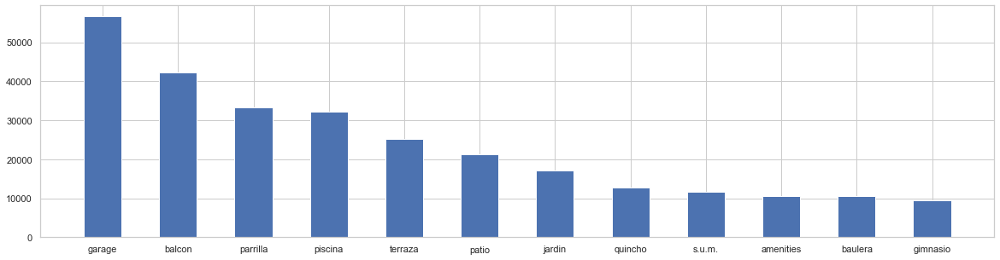

In [164]:
plt.figure(figsize=(20,5))
plt.bar(amenities_conteo.keys(), amenities_conteo.values(), width=.5)
plt.show()

# **Exportación de resultados**

In [165]:
#creo un nuevo dataset de salida con los métodos aplicados
# exportar a colab
#df.to_csv(r'/content/drive/MyDrive/DSDH/TP1/properatti_nuevo.csv', index = False, header=True)
#exportar local
data.to_csv(r'properatti_nuevo.csv', index = False, header=True)

# **Exploracion con GeoPandas**

### Preparación del enviroment

In [166]:
# esto es para COLAB

#_ = !conda install descartes=1.1.0
#_ = !conda install pyproj=2.4.2.post1
#_ = !conda install geopy=2.0.0
#_ = !conda install geopandas=0.8.1

In [167]:
# esto es para NO COLAB
#!pip install  pyproj==2.4.2.post1
#!pip install  descartes==1.1.0
#!pip install  geopy==2.0.0

In [168]:
#!pip install geopandas==0.8.1


In [169]:
#!conda activate ds_geopandas
#!conda install geopandas

In [170]:
import geopandas as gpd
import descartes
import pyproj
import geopy

### Graficos Geopandas - Exploracion de Puntos Geograficos

In [171]:
data_geo = data.copy()

In [172]:
geometria = gpd.points_from_xy(data_geo.lon, data_geo.lat)

In [173]:
geometria[0:2]

<GeometryArray>
[<shapely.geometry.point.Point object at 0x7f7ff502c810>, <shapely.geometry.point.Point object at 0x7f7ff502c890>]
Length: 2, dtype: geometry

In [174]:
geo_prop = gpd.GeoDataFrame(data_geo ,geometry=geometria)

In [175]:
type(geo_prop)

geopandas.geodataframe.GeoDataFrame

In [176]:
geo_prop.loc[:4, ['geometry', 'lat', 'lon','property_type','place_name','state_name','surface_total_in_m2','price_usd_per_m2']]

,geometry,lat,lon,property_type,place_name,state_name,surface_total_in_m2,price_usd_per_m2
0,POINT (-58.50884 -34.66182),-34.661824,-58.508839,PH,Mataderos,Capital Federal,55.0,1127.272727
1,POINT (-57.96433 -34.90388),-34.903883,-57.964330,apartment,La Plata,Bs.As. G.B.A. Zona Sur,NaN,NaN
2,POINT (-58.52298 -34.65226),-34.652262,-58.522982,apartment,Mataderos,Capital Federal,55.0,1309.090909
3,POINT (-58.51642 -34.64780),-34.647797,-58.516424,PH,Liniers,Capital Federal,NaN,NaN
4,POINT (-57.54945 -38.00263),-38.002626,-57.549447,apartment,Centro,Buenos Aires Costa Atlántica,35.0,1828.571429


In [177]:
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))

In [178]:
type(world)

geopandas.geodataframe.GeoDataFrame

In [179]:
world.head()

,pop_est,continent,name,iso_a3,gdp_md_est,geometry
0,920938,Oceania,Fiji,FJI,8374.0,"MULTIPOLYGON (((180.00000 -16.06713, 180.00000..."
1,53950935,Africa,Tanzania,TZA,150600.0,"POLYGON ((33.90371 -0.95000, 34.07262 -1.05982..."
2,603253,Africa,W. Sahara,ESH,906.5,"POLYGON ((-8.66559 27.65643, -8.66512 27.58948..."
3,35623680,North America,Canada,CAN,1674000.0,"MULTIPOLYGON (((-122.84000 49.00000, -122.9742..."
4,326625791,North America,United States of America,USA,18560000.0,"MULTIPOLYGON (((-122.84000 49.00000, -120.0000..."


In [180]:
world.loc[world.name=='Argentina']

,pop_est,continent,name,iso_a3,gdp_md_est,geometry
9,44293293,South America,Argentina,ARG,879400.0,"MULTIPOLYGON (((-68.63401 -52.63637, -68.25000..."


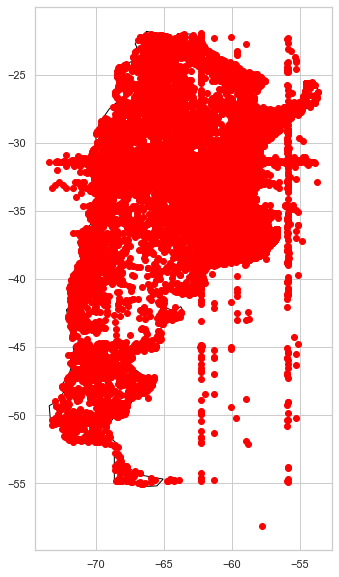

In [181]:

ax = world[world.name == 'Argentina'].plot(color='white', edgecolor='black', figsize=(10, 10))
geo_prop.plot(ax=ax, color='red')


### Grafico con pyplot.express

## Mapa con tamaño de burbujas por superficie y color por precio de propieades en usd

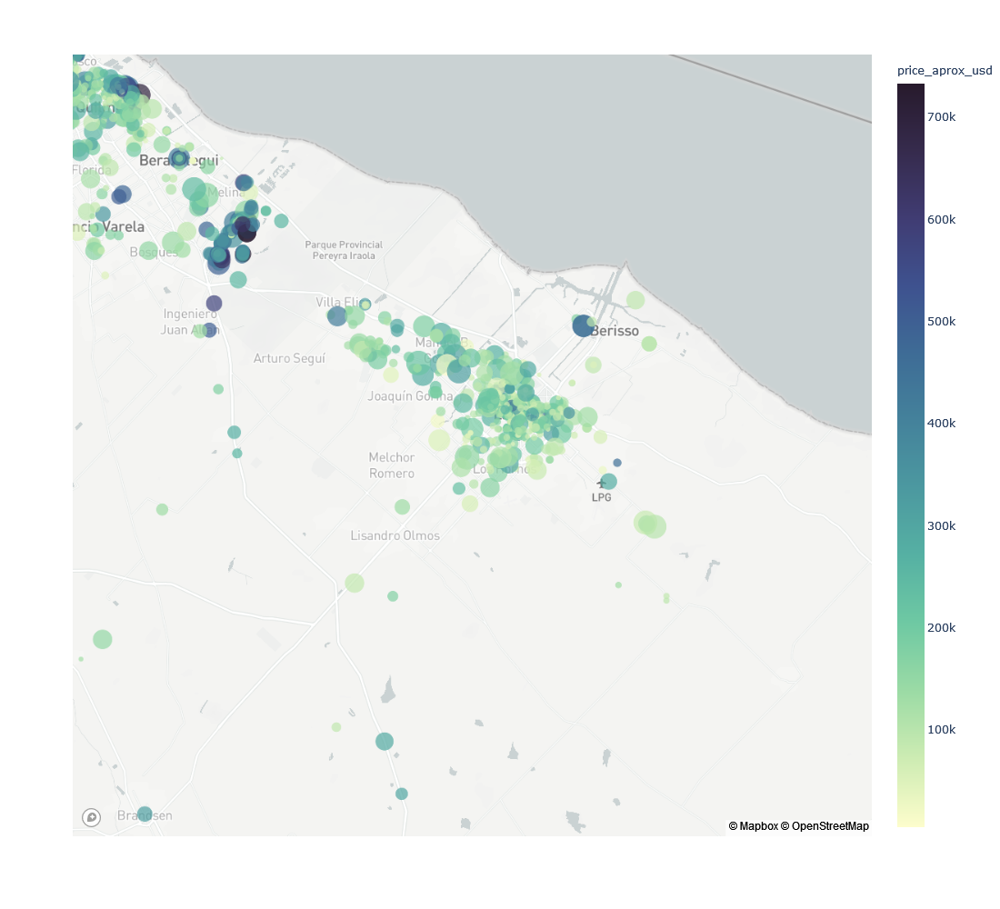

In [182]:
sf_q1, sf_q3, pr_q1, pr_q3 = data.surface_total_in_m2.quantile(0.25), data.surface_total_in_m2.quantile(0.75), data.price_aprox_usd.quantile(0.25), data.price_aprox_usd.quantile(0.75)
sf_iqr, pr_iqr = (sf_q3 - sf_q1) * 3, (pr_q3 - pr_q1) * 3
sf_lim_sup, sf_lim_inf, pr_lim_sup, pr_lim_inf = sf_q3 + sf_iqr, sf_q1 - sf_iqr, pr_q3 + pr_iqr, pr_q1 - pr_iqr
cond_sf = (data.surface_total_in_m2 >= sf_lim_inf) & (data.surface_total_in_m2 <= sf_lim_sup)
cond_pr = (data.price_aprox_usd >= pr_lim_inf) & (data.price_aprox_usd <= pr_lim_sup)
data_map = data.loc[np.logical_and(cond_sf, cond_pr)]

px.set_mapbox_access_token("pk.eyJ1IjoiejMwbiIsImEiOiJjbDJseHZpajgwZ2RvM2NwNmp0ejJmM3lxIn0.Rcr4j8AAbdo57-80HIYqYA")
fig = px.scatter_mapbox(data_map, lat = "lat", lon = "lon", color = "price_aprox_usd", size = "surface_total_in_m2", hover_data = {'lat': False, 'lon': False, 'price_aprox_usd': True, 'surface_total_in_m2': True, 'property_type': True, 'place_name': True}, color_continuous_scale = px.colors.sequential.deep, zoom = 10, height = 1000, center = {"lat":-34.94, "lon":-57.99})
fig.show()
# guardar sin COLAB
fig.write_html('DatosAuxGeo_price_usd_per.html')
# guardar con COLAB
#fig.write_html('/content/drive/MyDrive/DSDH/TP1/DatosAuxGeo_price_usd_per_m2.html')


## Mapa con tamaño de burbujas por superficie y color por precio por M2 de propieades en usd

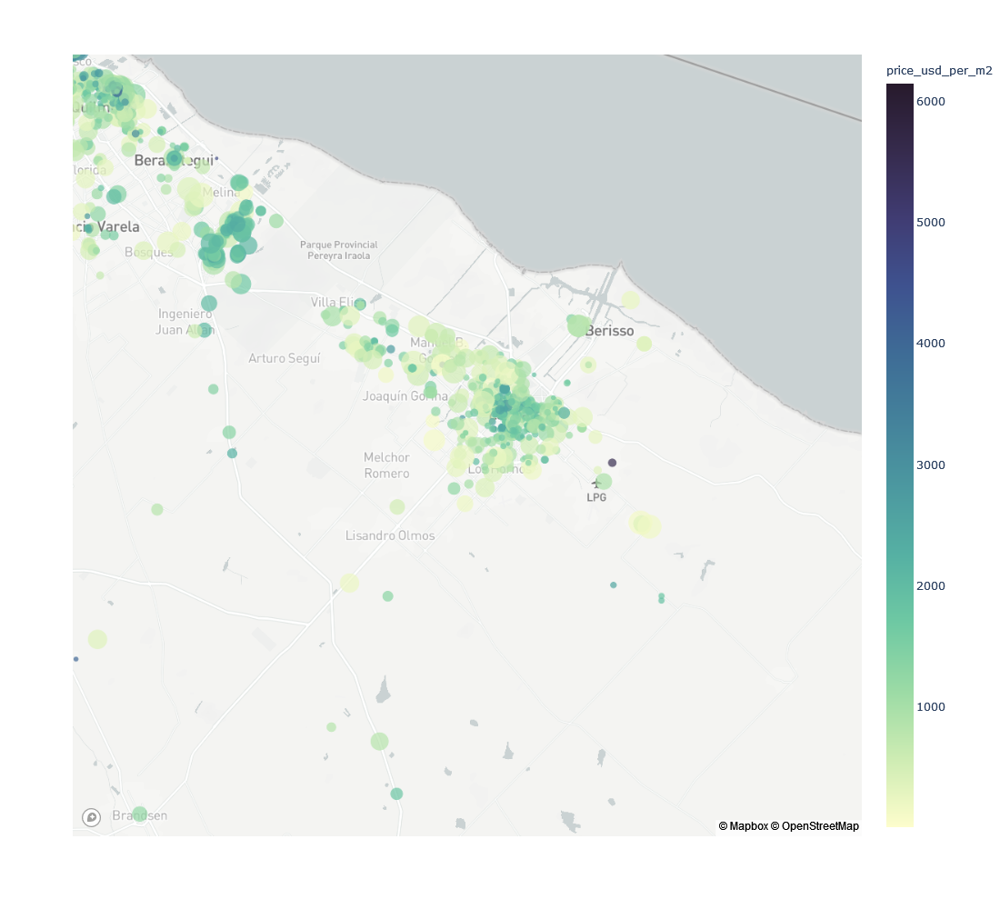

In [183]:
# REEMPLAZAMOS price_aprox_usd por price_usd_x_m2
sf_q1, sf_q3, pr_q1, pr_q3 = data.surface_total_in_m2.quantile(0.25), data.surface_total_in_m2.quantile(0.75), data.price_usd_per_m2.quantile(0.25), data.price_usd_per_m2.quantile(0.75)
sf_iqr, pr_iqr = (sf_q3 - sf_q1) * 3, (pr_q3 - pr_q1) * 3
sf_lim_sup, sf_lim_inf, pr_lim_sup, pr_lim_inf = sf_q3 + sf_iqr, sf_q1 - sf_iqr, pr_q3 + pr_iqr, pr_q1 - pr_iqr
cond_sf = (data.surface_total_in_m2 >= sf_lim_inf) & (data.surface_total_in_m2 <= sf_lim_sup)
cond_pr = (data.price_usd_per_m2 >= pr_lim_inf) & (data.price_usd_per_m2 <= pr_lim_sup)
data_map = data.loc[np.logical_and(cond_sf, cond_pr)]

px.set_mapbox_access_token("pk.eyJ1IjoiejMwbiIsImEiOiJjbDJseHZpajgwZ2RvM2NwNmp0ejJmM3lxIn0.Rcr4j8AAbdo57-80HIYqYA")
fig = px.scatter_mapbox(data_map, lat = "lat", lon = "lon", color = "price_usd_per_m2", size = "surface_total_in_m2", hover_data = {'lat': False, 'lon': False, 'price_aprox_usd': True, 'surface_total_in_m2': True, 'property_type': True, 'place_name': True}, color_continuous_scale = px.colors.sequential.deep, zoom = 10, height = 1000, center = {"lat":-34.94, "lon":-57.99})
fig.show()
# guardar sin COLAB
fig.write_html('DatosAuxGeo_price_usd_per_m2.html')
# guardar con COLAB
#fig.write_html('/content/drive/MyDrive/DSDH/TP1/DatosAuxGeo_price_usd_per_m2.html')